# V928 Tau - Eclipse

In this notebook we take the output of the stellar variation notebook and model the eclipse. We do this using the <strong>pyPplusS</strong> package designed by Rein & Odir 2019. We make the assumption that the two components of the binary are identical and thus that the deblended light curve just doubles the fluctuations about 1.

In [1]:
import emcee
import logging
import numpy as np
import astropy.units as u
import astropy.constants as c
import matplotlib.pyplot as plt
from Code import mcmc, eclipse

%matplotlib inline

## Load the Data

In [2]:
time, flux_b, flux, error = eclipse.load_data('data/photometry/eclipse_lightcurve.txt')

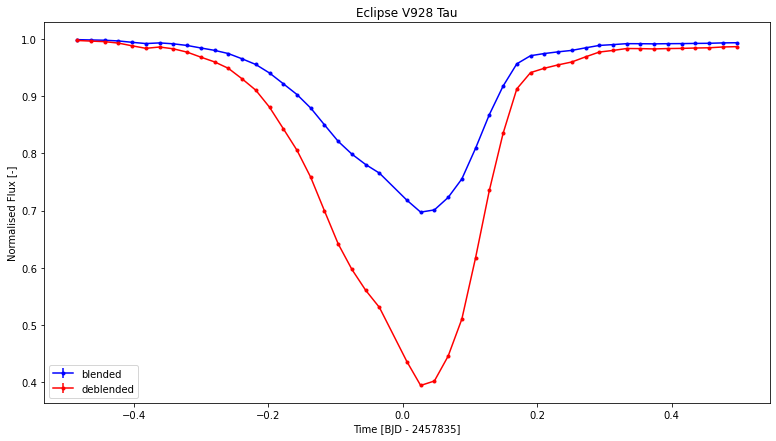

In [3]:
plt.figure(figsize=(13, 7))
plt.title('Eclipse V928 Tau')
plt.xlabel('Time [BJD - 2457835]')
plt.ylabel('Normalised Flux [-]')
plt.errorbar(time, flux_b, yerr=error, fmt='.', color='b', ls='-', label='blended')
plt.errorbar(time, flux, yerr=error, fmt='.', color='r', ls='-', label='deblended')
plt.legend()
plt.show()

## Model Set-up

This takes the <strong>disk_model()</strong> function from <strong>eclipse_functions</strong>, and creates sub-functions for:

* fuzzy_disk --> n.a.
* translucent_disk --> redge = 0, tau_edge = 0
* opaque_disk --> redge = 0, tau_edge = 0, tau_disk = 0

In [4]:
# packing functions
pack_td = lambda rd, b, inc, tilt, vel, dx, taud: (rd, 0., b, inc, tilt, vel, dx, taud, 0.)
pack_od = lambda rd, b, inc, tilt, vel, dx: (rd, 0., b, inc, tilt, vel, dx, 1., 0.)

# all the disk model variants
fuzzy_disk       = eclipse.disk_model
translucent_disk = lambda P, time: eclipse.disk_model(pack_td(*P), time)
opaque_disk      = lambda P, time: eclipse.disk_model(pack_od(*P), time)

# all the disk prior variants
fuzzy_prior       = eclipse.disk_prior
translucent_prior = lambda P: eclipse.disk_prior(pack_td(*P))
opaque_prior      = lambda P: eclipse.disk_prior(pack_od(*P))


In [5]:
# Bounds of the parameters (t = tilt, T = tau, rest as above)
rl, ru = (0., 10.)
bl, bu = (-10.,10.)
il, iu = (0., np.pi/2.)
tl, tu = (0., np.pi/2.)
vl, vu = (5.9, 20.)
xl, xu = (-10.,10.)
Tl, Tu = (0.,1.)

## Opaque Disk

In [6]:
# setting the the parameter names, units and bounds
lbls_od = ['disk radius', 'impact parameter', 'inclination', 'tilt', 'velocity', 
           'time shift']
units_od = ['R*', 'R*', 'deg', 'deg', 'R*/day', 'day']
bounds_od = [(rl, ru/2.), (bl/2., bu/2.), (iu/2., iu), (tl, tu), (vl, vu/2.), (-0.5, 0.5)]

# set-up intial guess for the opaque disk
pargs_od = (6, 1000, bounds_od)
p0_od = eclipse.useful_p0(mcmc.bounded_p0, pargs_od, opaque_disk, time, False, 4)

  1%|          | 6/1000 [00:00<00:17, 56.05it/s]

round 1 from 0 to 724 (max = 1000)


  0%|          | 2/1000 [00:00<01:01, 16.18it/s]

round 2 from 724 to 1000 (max = 1000)


  3%|▎         | 8/267 [00:00<00:03, 78.10it/s]

ran a for loop
USEFUL ROUND 1 FROM 0 TO 733 (MAX = 1000)



  3%|▎         | 8/267 [00:00<00:03, 76.04it/s]

round 1 from 0 to 193 (max = 267)


  0%|          | 0/267 [00:00<?, ?it/s]

round 2 from 193 to 267 (max = 267)


 11%|█         | 8/75 [00:00<00:00, 73.56it/s]

ran a for loop
USEFUL ROUND 2 FROM 733 TO 925 (MAX = 1000)



 11%|█         | 8/75 [00:00<00:00, 74.91it/s]

round 1 from 0 to 53 (max = 75)


  3%|▎         | 2/75 [00:00<00:04, 14.62it/s]

round 2 from 53 to 75 (max = 75)


 47%|████▋     | 8/17 [00:00<00:00, 76.17it/s]

ran a for loop
USEFUL ROUND 3 FROM 925 TO 983 (MAX = 1000)



  0%|          | 0/17 [00:00<?, ?it/s]

round 1 from 0 to 11 (max = 17)
round 2 from 11 to 17 (max = 17)


  0%|          | 0/5 [00:00<?, ?it/s]

ran a for loop
USEFUL ROUND 4 FROM 983 TO 995 (MAX = 1000)

round 1 from 0 to 4 (max = 5)
round 2 from 4 to 5 (max = 5)


  0%|          | 0/1 [00:00<?, ?it/s]

ran a for loop
USEFUL ROUND 5 FROM 995 TO 999 (MAX = 1000)

round 1 from 0 to 1 (max = 1)
ran a for loop
USEFUL ROUND 6 FROM 999 TO 1000 (MAX = 1000)



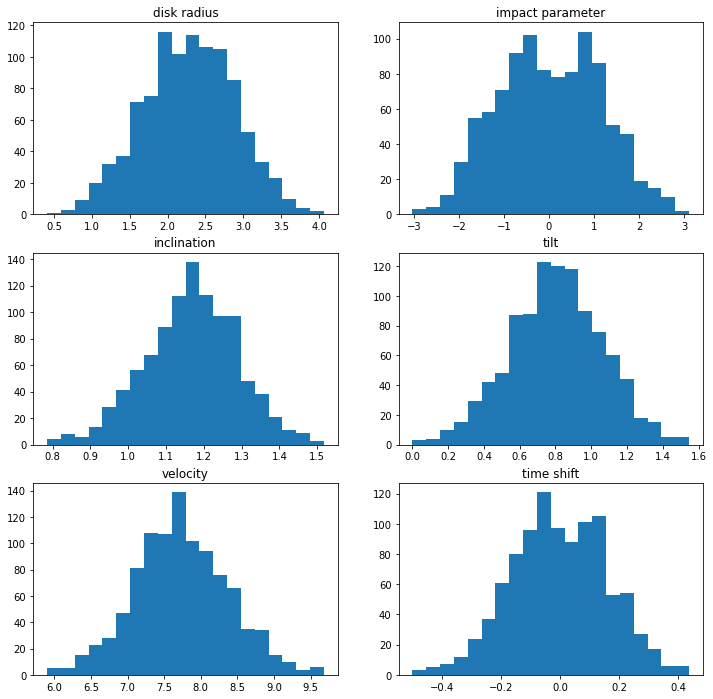

In [7]:
# plot intial guess histogram
mcmc.plot_hist(p0_od, lbls=lbls_od)

In [8]:
# mcmc parameters for opaque disk
be_od = 'models/mcmc_backends/opaque_disk.h5'
args_od = (time, flux, error, opaque_disk, opaque_prior)
BE_od = emcee.backends.HDFBackend(be_od)

# run mcmc for opaque disk
#p_od, sampler_od = mcmc.run_mcmc(*args_od, p0_od, 1000, reset=False, savename=be_od)

# load mcmc for opaque disk
sampler_od = emcee.EnsembleSampler(1000, 6, mcmc.lnprob, args=args_od, backend=BE_od)

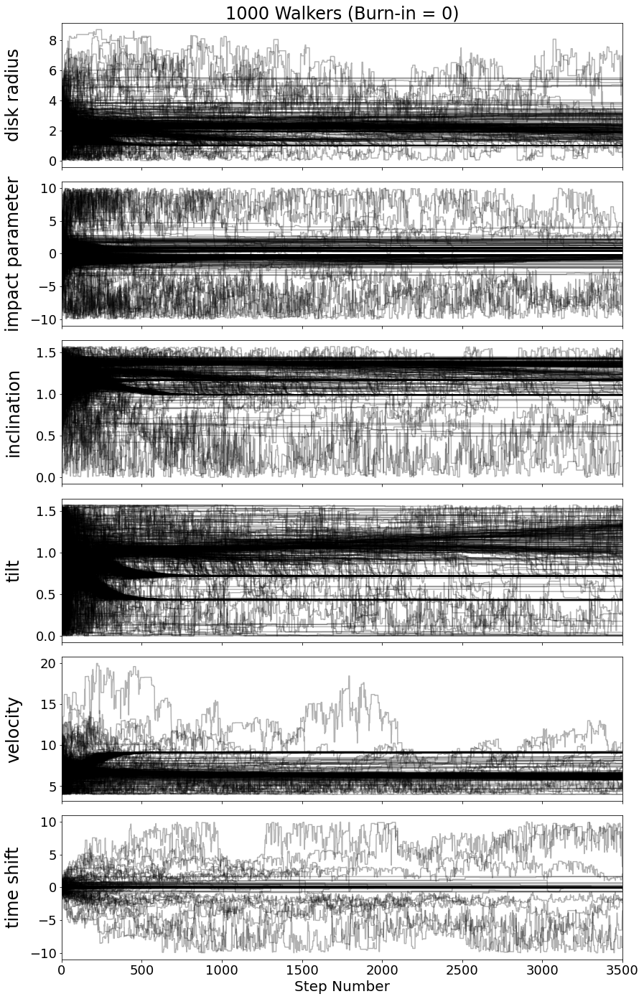

In [9]:
# plot the walkers for the opaque disk
mcmc.plot_walkers(sampler_od, lbls=lbls_od)

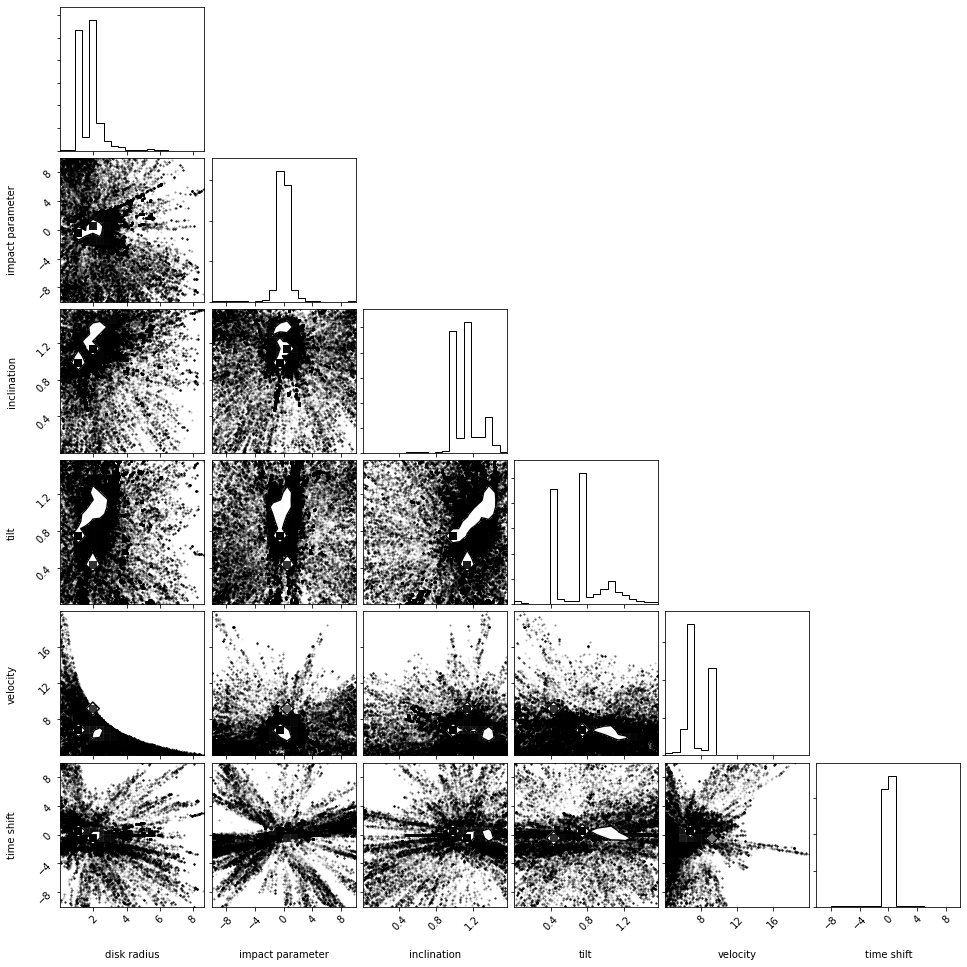

In [10]:
# plot the triangle for the opaque disk
mcmc.plot_triangle(sampler_od, lbls=lbls_od)

From these plots it is very clear that there are two very sharp solutions. This is clear from two high peaks in disk radius, two high peaks in inclination (a smaller third), two high peaks in tilt (a smaller third), two peaks in velocity. Note also that impact parameter and time shift are very thick peaks (possibly two next to each other). As becomes apparent from the orbital analysis notebook velocity is key, so we'll start by extracting the velocity solutions.

### Separating Solutions (Velocity) for the Opaque Disk

Here we extract the solutions with velocities above and below 8 $R_*$/day.

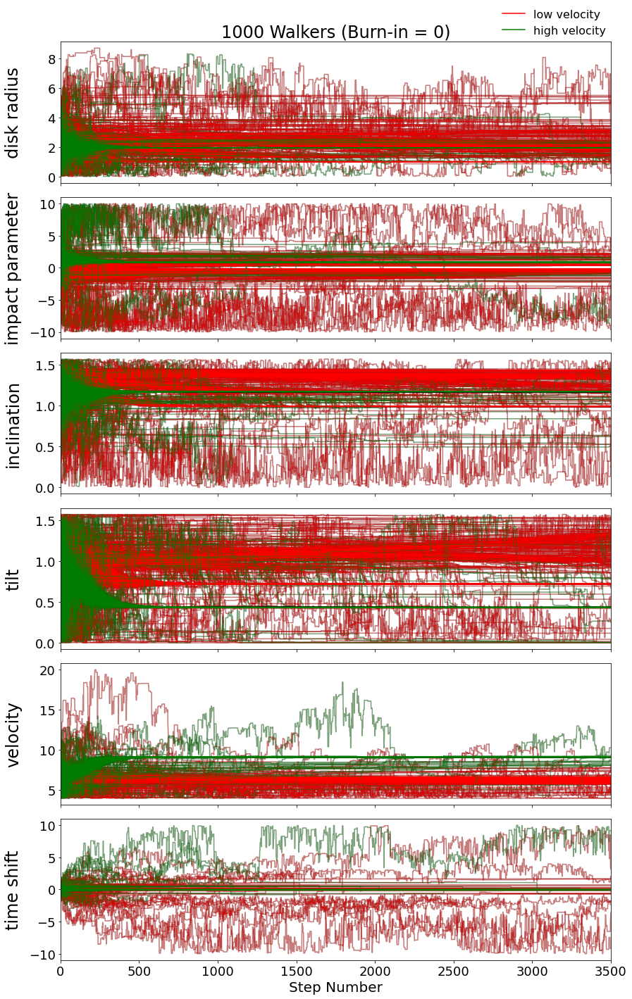

In [11]:
# extracting the low and high velocity solutions for the opaque disk
vel_names_od = ['low velocity', 'high velocity']
lvel_od, hvel_od = mcmc.extract_solutions(sampler_od, [4, 4], [(0, 8), (8, 20)], 0, lbls_od, vel_names_od)


#### High Velocity Solutions for the Opaque Disk

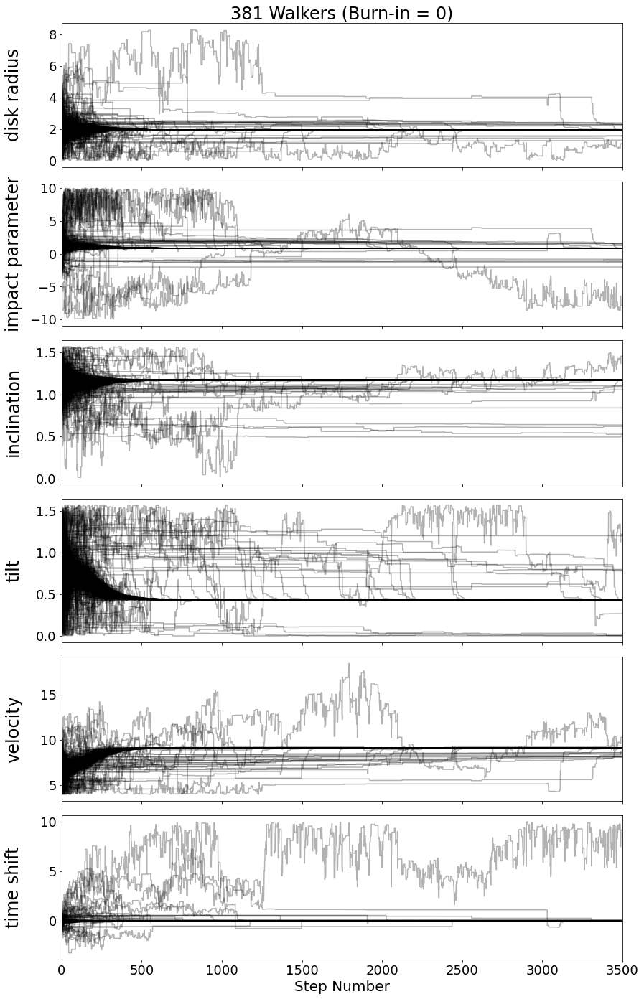

In [12]:
# plot the high velocity walkers for the opaque disk
mcmc.plot_walkers(hvel_od, lbls=lbls_od)

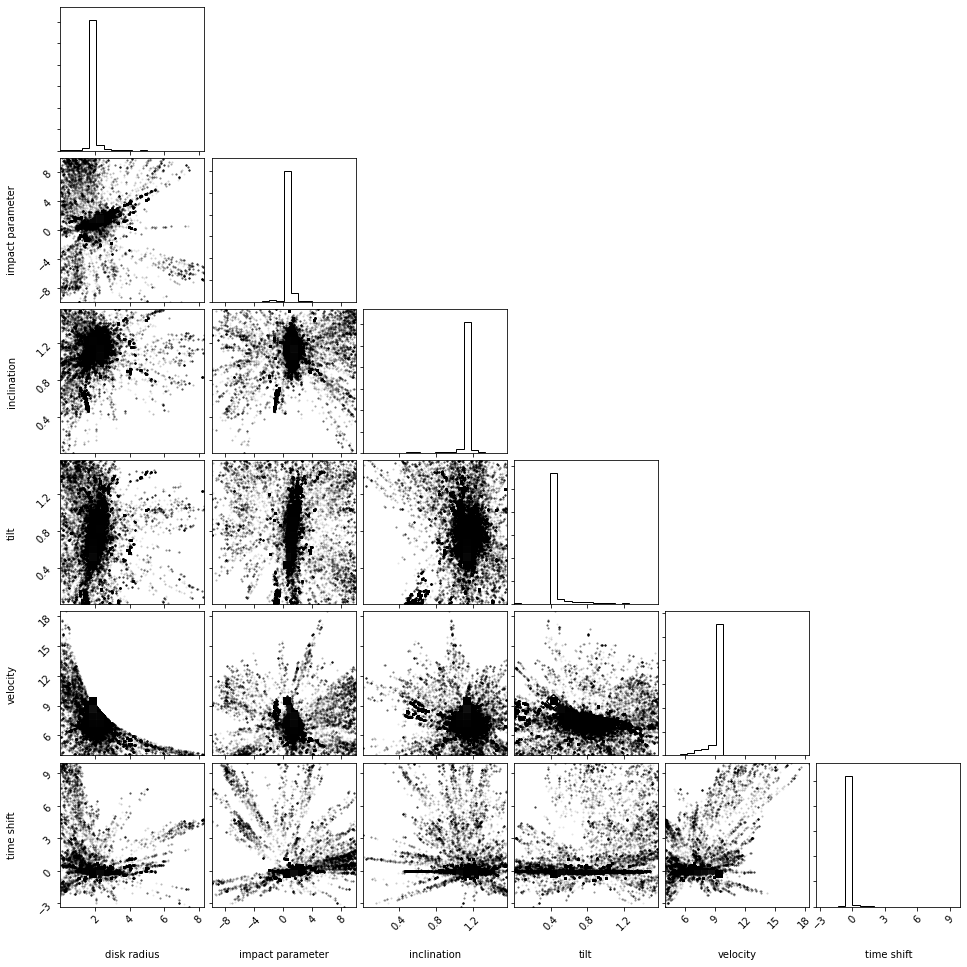

In [13]:
# plot the high velocity triangle for the opaque disk
mcmc.plot_triangle(hvel_od, lbls=lbls_od)

Clearly there is just one peak where everything moves to so we can cut away the burn-in time and carry out the statistics to get a best fit solution for the high-velocity set of solutions. To check we plot the walkers and the triangle plot.

100%|██████████| 500/500 [00:38<00:00, 12.84it/s]


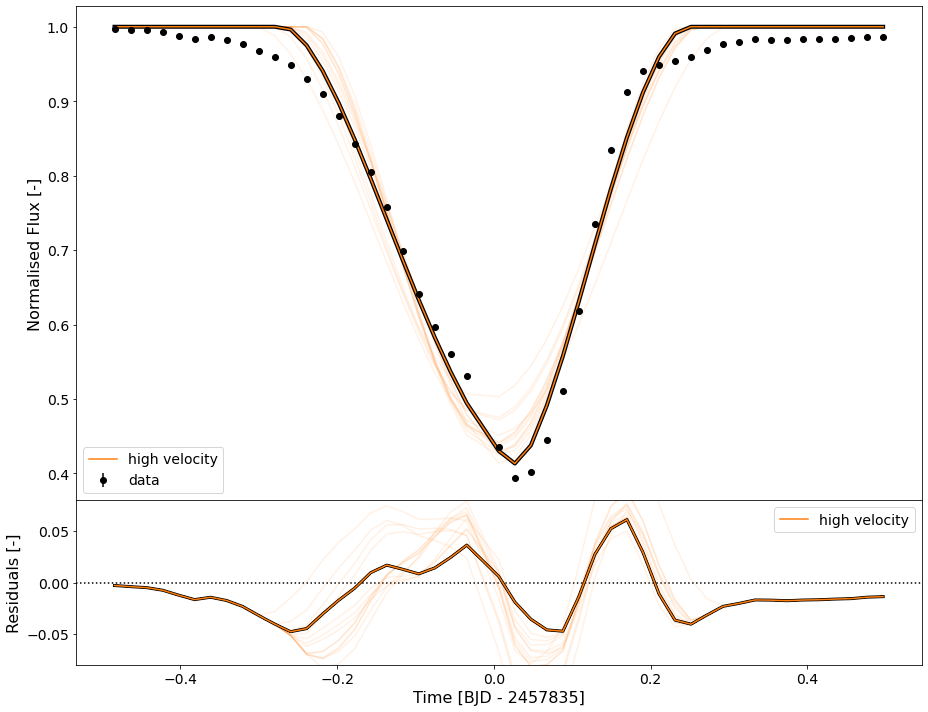

In [14]:
# deciding the burn-in for the high velocity solutions for the opaque disk
cut_hvel_od = 500

# carrying out statistics for the high velocity solutions for the opaque disk
stats_hvel_od, pb_hvel_od = mcmc.stats(hvel_od, cut=cut_hvel_od)

# making plot of the samples for the high velocity solutions for the opaque disk
_ = mcmc.plot_samples(time, flux, error, [opaque_disk], [hvel_od], ['high velocity'], cut_hvel_od, 500, 
                      best_fit=True, dt=3002, residual_lims=(-0.08, 0.08))

In [15]:
# printing the high velocity best-fit solution for the opaque disk
mcmc.print_parameters(pb_hvel_od, lbls_od, units_od)

disk radius        =     +1.939238     [R*]
impact parameter   =     +0.851913     [R*]
inclination        =     +67.11369     [deg]
tilt               =     +24.83339     [deg]
velocity           =     +9.135350     [R*/day]
time shift         =     -0.058551     [day]


#### Low Velocity Solutions for the Opaque Disk

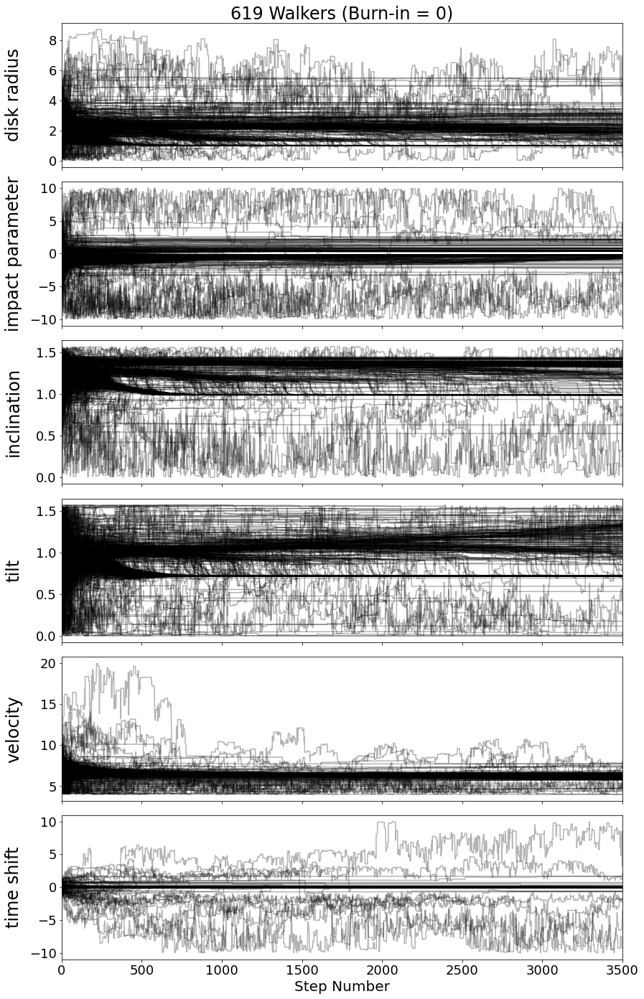

In [16]:
# plot the low velocity walkers for the opaque disk
mcmc.plot_walkers(lvel_od, lbls=lbls_od)

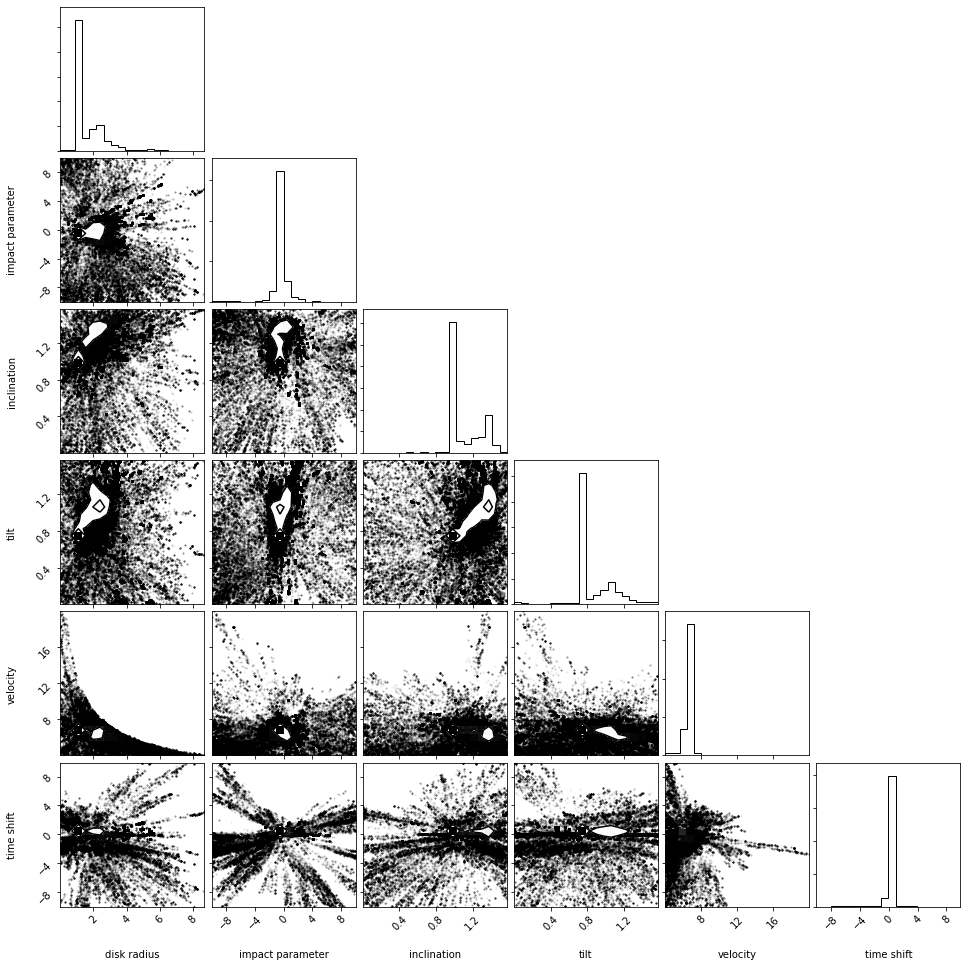

In [17]:
# plot the low velocity triangle for the opaque disk
mcmc.plot_triangle(lvel_od, lbls=lbls_od)

These plots suggest that there are two peaks. These are visible in radius, inclination, and tilt. We focus on the disk radius split as we are interested in the smallest solutions of the disk.

### Separating Low Velocity Solutions (Disk Radius) for the Opaque Disk

Here we extract the solutions with disk radii below and above 1.5 $R_*$

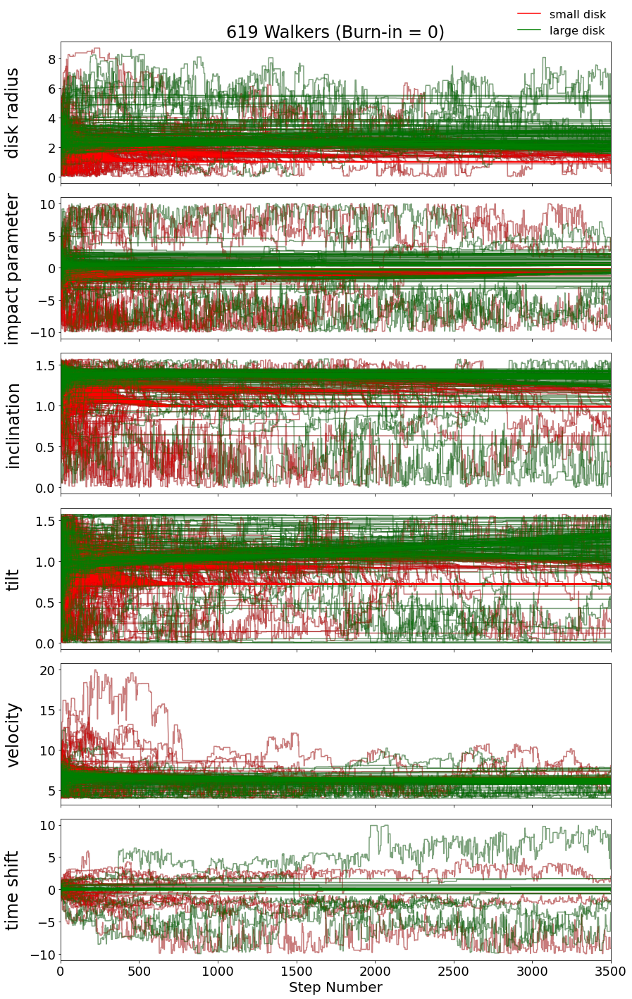

In [18]:
# extract low velocity disk radii solutions for the opaque disk
dr_names_od = ['small disk', 'large disk']
ldr_od, hdr_od = mcmc.extract_solutions(lvel_od, [0, 0], [(0, 1.5), (1.5, 20)], 0, lbls_od, dr_names_od)

#### Low Velocity, High Disk Radii Solutions for the Opaque Disk

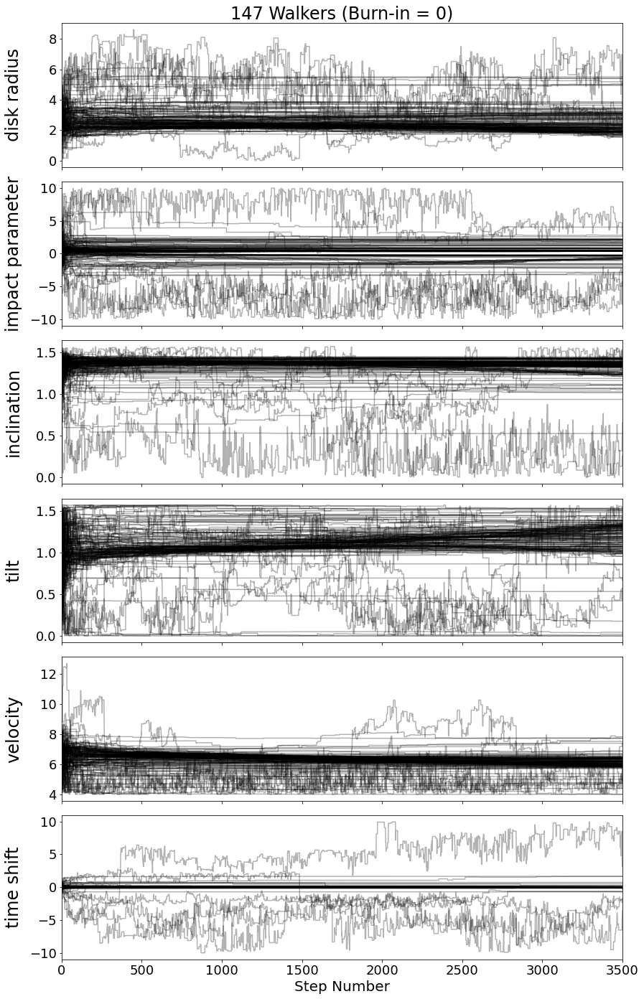

In [19]:
# plot the low velocity high disk radii walkers for the opaque disk
mcmc.plot_walkers(hdr_od, lbls=lbls_od)

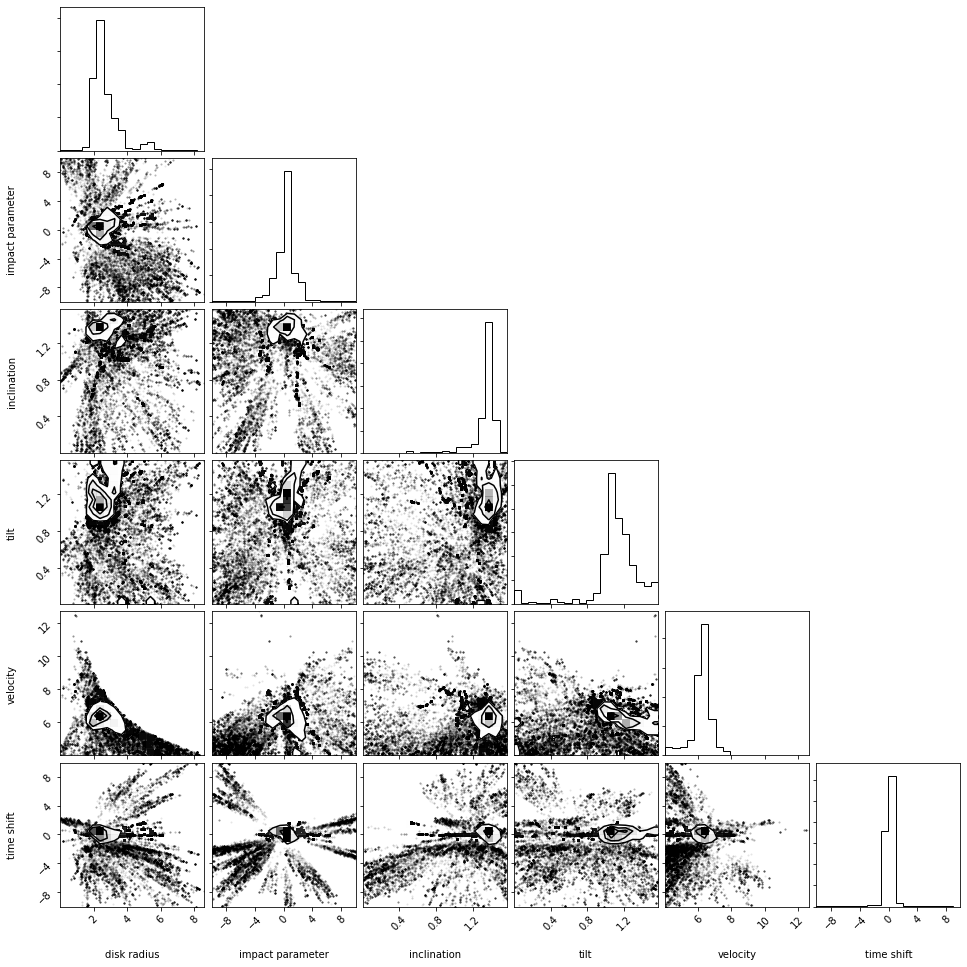

In [20]:
# plot the low velocity high disk radii triangle for the opaque disk
mcmc.plot_triangle(hdr_od, lbls=lbls_od)

We see one solution, but we see a very wide spread, and this is because we have only 147 walkers. Note that this is less than 15% of the original sample. Due to this fact we scrap this solution.

# CHECK THE PB ON THIS AND WHETHER YOU WANT TO CONTINUE HERE

100%|██████████| 500/500 [00:35<00:00, 13.89it/s]


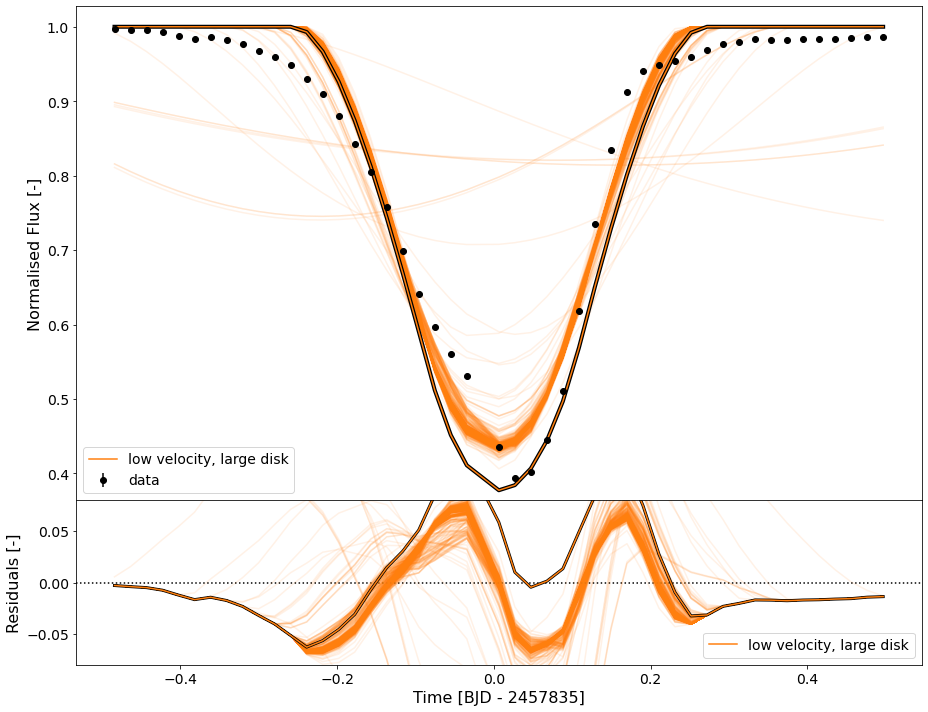

In [21]:
# determine burn-in for the low velocity high disk radii solutions for the opaque disk
cut_hdr_od = 500

# carry out statistics for the low velocity high disk radii solutions for the opaque disk
stats_hdr_od, pb_hdr_od = mcmc.stats(hdr_od, cut=cut_hdr_od)

# plotting samples for the low velocity high disk radii solutions for the opaque disk
_ = mcmc.plot_samples(time, flux, error, [opaque_disk], [hdr_od], ['low velocity, large disk'], cut_hdr_od, 
                      500, best_fit=True, dt=3002, residual_lims=(-0.08, 0.08))

In [22]:
# printing best-fit parameters for the low velocity high disk radii solutions for the opaque disk
mcmc.print_parameters(pb_hdr_od, lbls_od, units_od)

disk radius        =     +2.388550     [R*]
impact parameter   =     +0.392506     [R*]
inclination        =     +78.25017     [deg]
tilt               =     +64.24264     [deg]
velocity           =     +6.252525     [R*/day]
time shift         =     -0.019285     [day]


#### Low Velocity, Small Disk Radii Solutions for the Opaque Disk

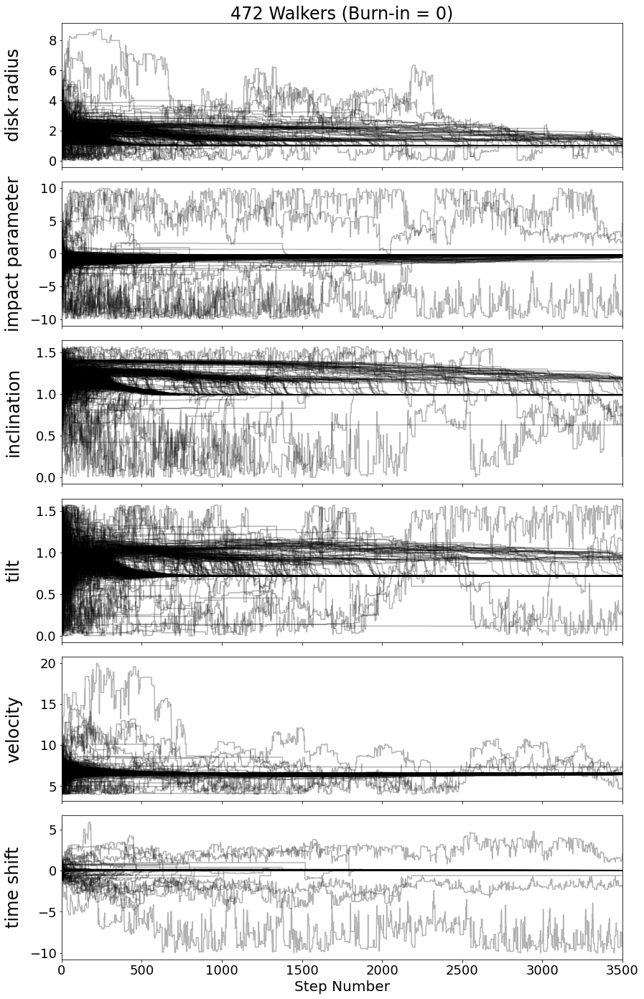

In [23]:
# plot the low velocity low disk radii walkers for the opaque disk
mcmc.plot_walkers(ldr_od, lbls=lbls_od)

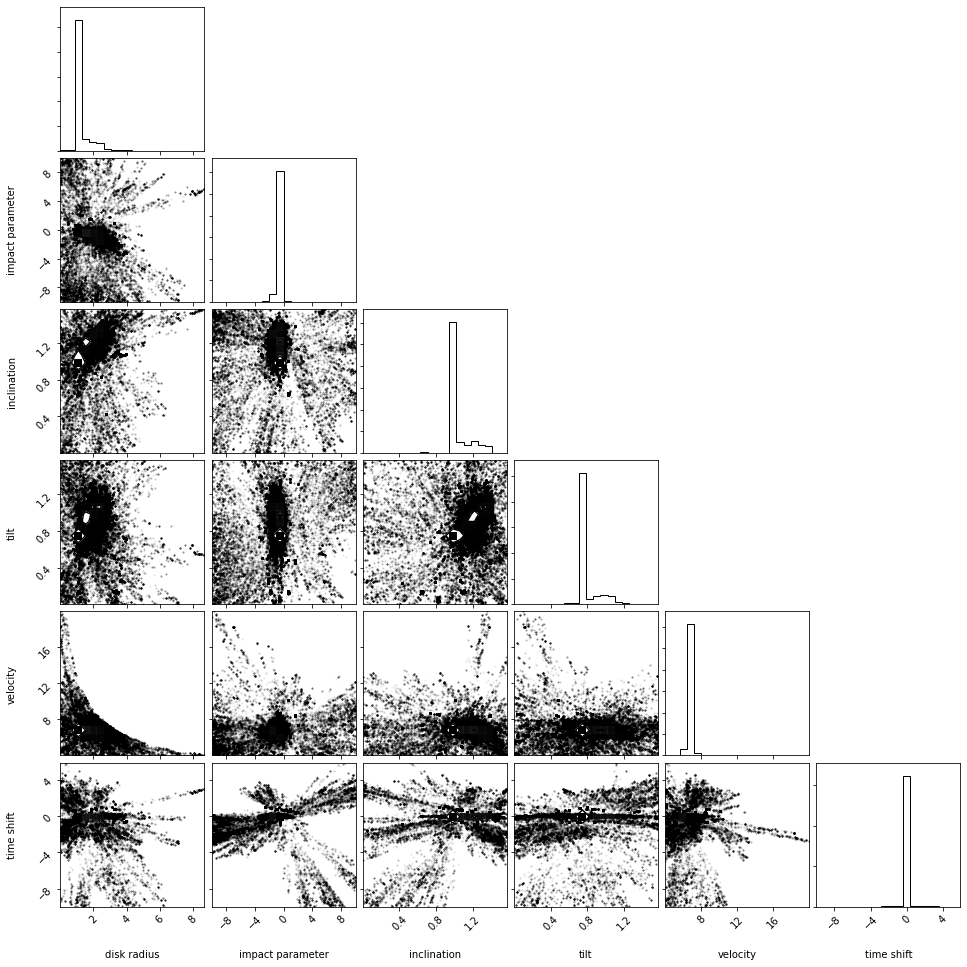

In [24]:
# plot the low velocity low disk radii triangle for the opaque disk
mcmc.plot_triangle(ldr_od, lbls=lbls_od)

Looks like one solution, let's cut out the burn-in (1000 steps)

100%|██████████| 500/500 [00:39<00:00, 12.52it/s]


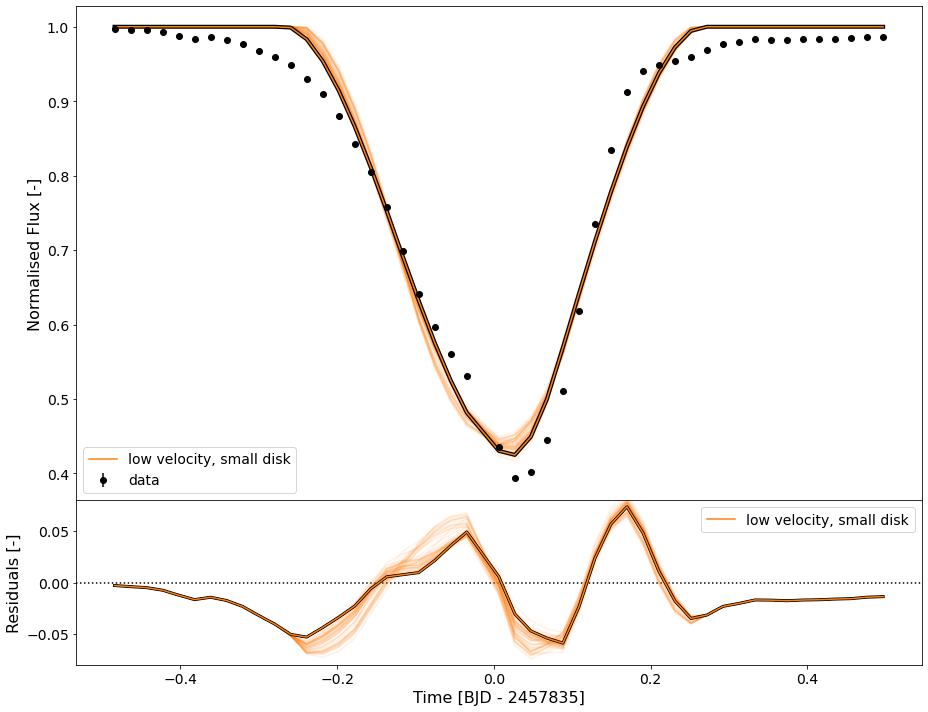

In [25]:
# determining the burn-in for the low velocity low disk radii solutions for the opaque disk
cut_ldr_od = 1000

# carrying out statistics for the low velocity low disk radii solutions for the opaque disk
stats_ldr_od, pb_ldr_od = mcmc.stats(ldr_od, cut=cut_ldr_od)

# plotting samples for the low velocity low disk radii solutions for the opaque disk
_ = mcmc.plot_samples(time, flux, error, [opaque_disk], [ldr_od], ['low velocity, small disk'], cut_ldr_od, 
                      500, best_fit=True, dt=3002, residual_lims=(-0.08, 0.08))

In [26]:
# printing best fit parameters for the low velocity low disk radii solutions for the opaque disk
mcmc.print_parameters(pb_ldr_od, lbls_od, units_od)

disk radius        =     +0.992294     [R*]
impact parameter   =     -0.250570     [R*]
inclination        =     +56.78165     [deg]
tilt               =     +41.21967     [deg]
velocity           =     +6.636696     [R*/day]
time shift         =     +0.009899     [day]


### Compare Opaque Disk Solutions

Here we compare all the opaque disk solutions in the preceding sections.

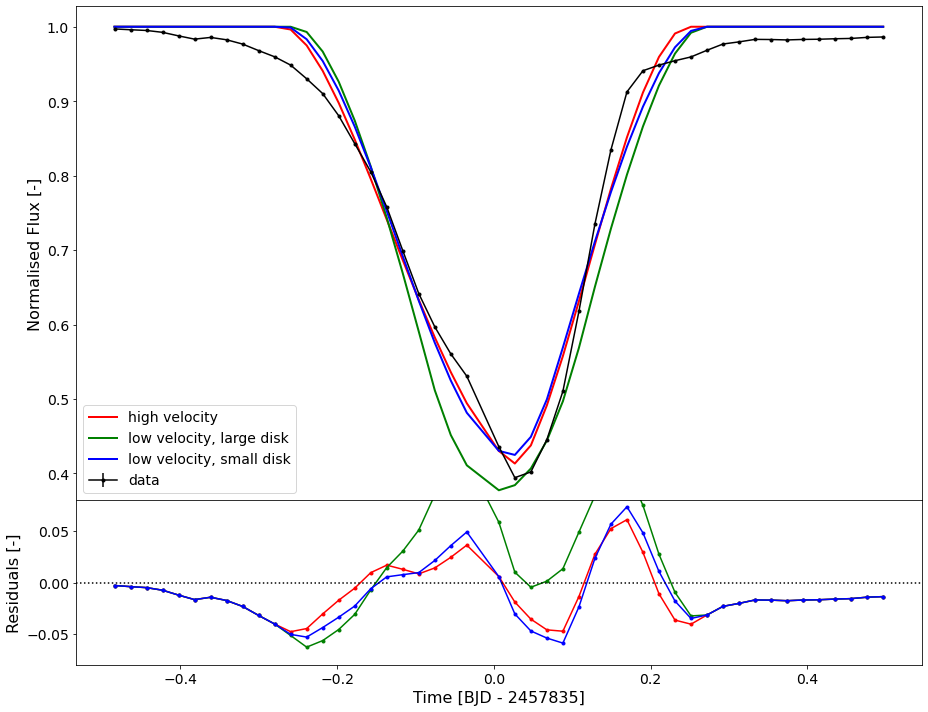

In [27]:
chi2s_od = mcmc.plot_models(time, flux, error, 3*[opaque_disk], [pb_hvel_od, pb_hdr_od, pb_ldr_od], 
                      ['high velocity', 'low velocity, large disk','low velocity, small disk'], 
                      dt=3002, residual_lims=(-0.08, 0.08), lw=2)

In [28]:
print('chi2 for the opaque disk with high velocity is -            %.6f' % chi2s_od[0])
print('chi2 for the opaque disk with low velocity, large disk is - %.6f' % chi2s_od[1])
print('chi2 for the opaque disk with low velocity, small disk is - %.6f' % chi2s_od[2])

chi2 for the opaque disk with high velocity is -            2682623.114875
chi2 for the opaque disk with low velocity, large disk is - 8069897.153828
chi2 for the opaque disk with low velocity, small disk is - 3540937.085071


## Translucent Disk

In [29]:
# Set up parameter labels, units and bounds for the translucent disk
lbls_td = ['disk radius', 'impact parameter', 'inclination', 'tilt', 'velocity', 
           'time shift', 'disk opacity']
units_td = ['R*', 'R*', 'deg', 'deg', 'R*/day', 'day', '-']
bounds_td = [(rl, ru/2.), (bl/2., bu/2.), (iu/2., iu), (tl, tu), (vl, vu/2.), 
             (-0.5, 0.5), (Tu/2., Tu)]

# determine an initial guess for the MCMC distribution for the translucent disk
pargs_td = (7, 1000, bounds_td)
p0_td = eclipse.useful_p0(mcmc.bounded_p0, pargs_td, translucent_disk, time, False, 4)


  1%|          | 8/1000 [00:00<00:12, 77.39it/s]

round 1 from 0 to 735 (max = 1000)


  0%|          | 3/1000 [00:00<00:33, 29.38it/s]

round 2 from 735 to 1000 (max = 1000)


  3%|▎         | 8/259 [00:00<00:03, 72.10it/s]

ran a for loop
USEFUL ROUND 1 FROM 0 TO 741 (MAX = 1000)



  3%|▎         | 7/259 [00:00<00:03, 68.32it/s]

round 1 from 0 to 185 (max = 259)


  2%|▏         | 5/259 [00:00<00:09, 27.24it/s]

round 2 from 185 to 259 (max = 259)


  9%|▉         | 7/78 [00:00<00:01, 65.95it/s]

ran a for loop
USEFUL ROUND 2 FROM 741 TO 922 (MAX = 1000)



  9%|▉         | 7/78 [00:00<00:01, 65.89it/s]

round 1 from 0 to 59 (max = 78)


  3%|▎         | 2/78 [00:00<00:03, 19.12it/s]

round 2 from 59 to 78 (max = 78)


 39%|███▉      | 7/18 [00:00<00:00, 64.68it/s]

ran a for loop
USEFUL ROUND 3 FROM 922 TO 982 (MAX = 1000)



  0%|          | 0/18 [00:00<?, ?it/s]

round 1 from 0 to 12 (max = 18)
round 2 from 12 to 18 (max = 18)


  0%|          | 0/5 [00:00<?, ?it/s]

ran a for loop
USEFUL ROUND 4 FROM 982 TO 995 (MAX = 1000)

round 1 from 0 to 4 (max = 5)
round 2 from 4 to 5 (max = 5)


  0%|          | 0/1 [00:00<?, ?it/s]

ran a for loop
USEFUL ROUND 5 FROM 995 TO 999 (MAX = 1000)

round 1 from 0 to 1 (max = 1)
ran a for loop
round 1 from 0 to 1 (max = 1)
ran a for loop
round 1 from 0 to 1 (max = 1)
ran a for loop
USEFUL ROUND 6 FROM 999 TO 1000 (MAX = 1000)



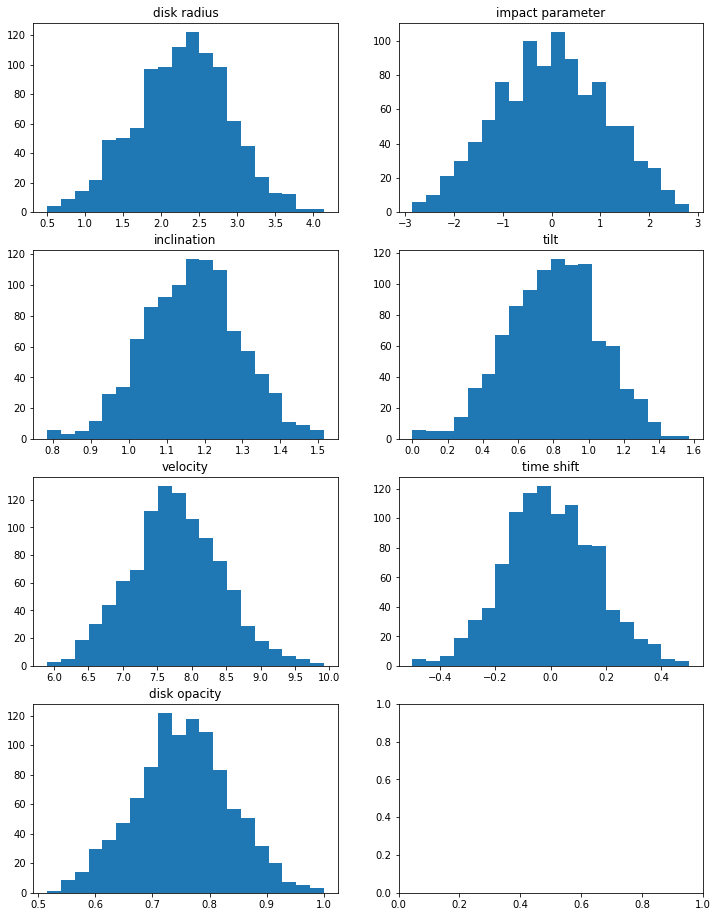

In [30]:
# plot the solutions for the translucent disk
mcmc.plot_hist(p0_td, lbls=lbls_td)

In [31]:
# mcmc parameters for the translucent disk
be_td = 'models/mcmc_backends/translucent_disk.h5'
args_td = (time, flux, error, translucent_disk, translucent_prior)
BE_td = emcee.backends.HDFBackend(be_td)

# run mcmc for the translucent disk
#p_td, sampler_td = mcmc.run_mcmc(*args_td, p0_td, 1500, reset=False, savename=be_td)

# load mcmc for the translucent disk
sampler_td = emcee.EnsembleSampler(1000, 7, mcmc.lnprob, args=args_td, backend=BE_td)


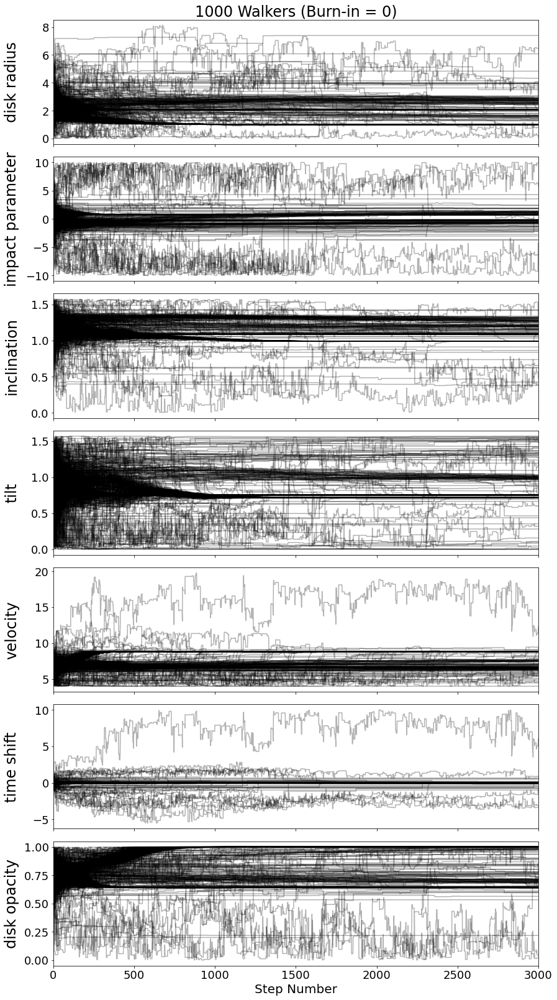

In [32]:
# plot the walkers for the translucent disk
mcmc.plot_walkers(sampler_td, lbls=lbls_td)

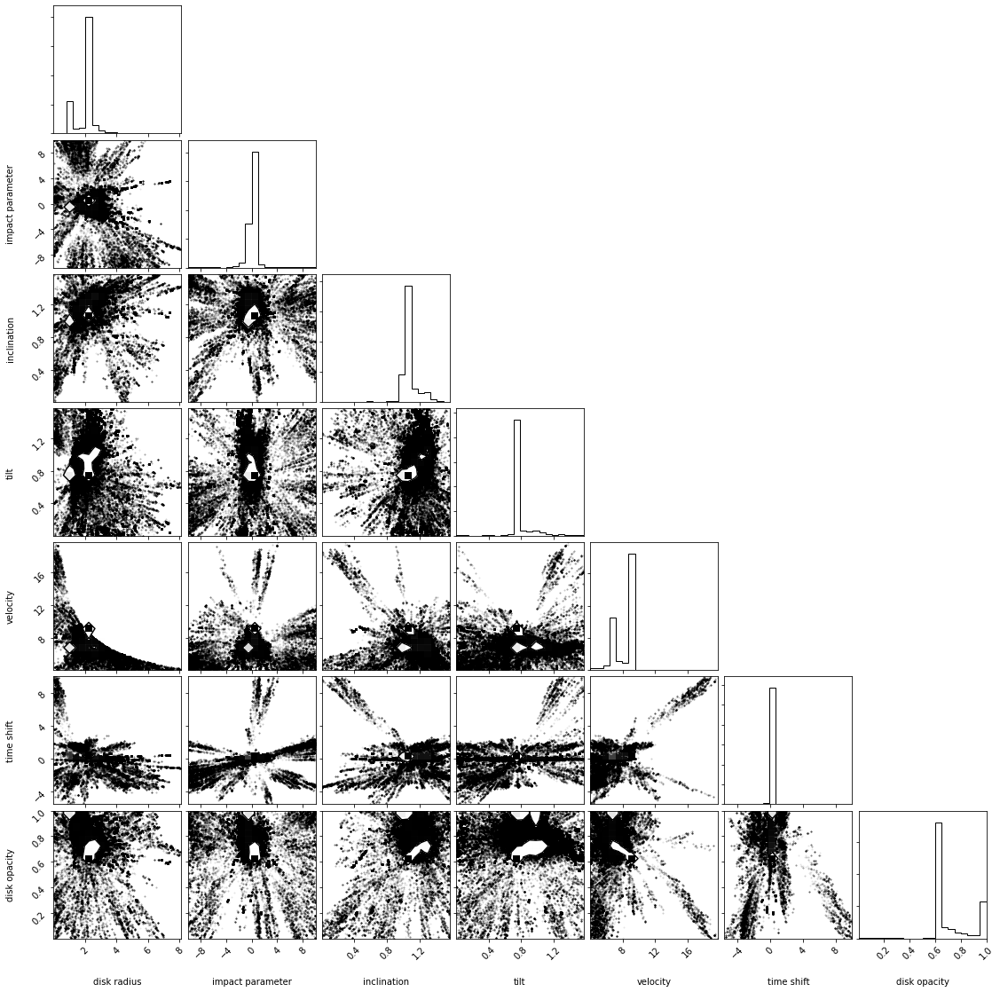

In [33]:
# plot the triangle for the translucent disk
mcmc.plot_triangle(sampler_td, lbls=lbls_td)

Here we clearly see two solutions separated and as before we'll start by separating by velocity. Ironically we again see a split at about 8 $R_*$/day.

### Separating Solutions (Velocity) for the Translucent Disk

Here we extract the solutions with velocities below and above 8 $R_*$/day.

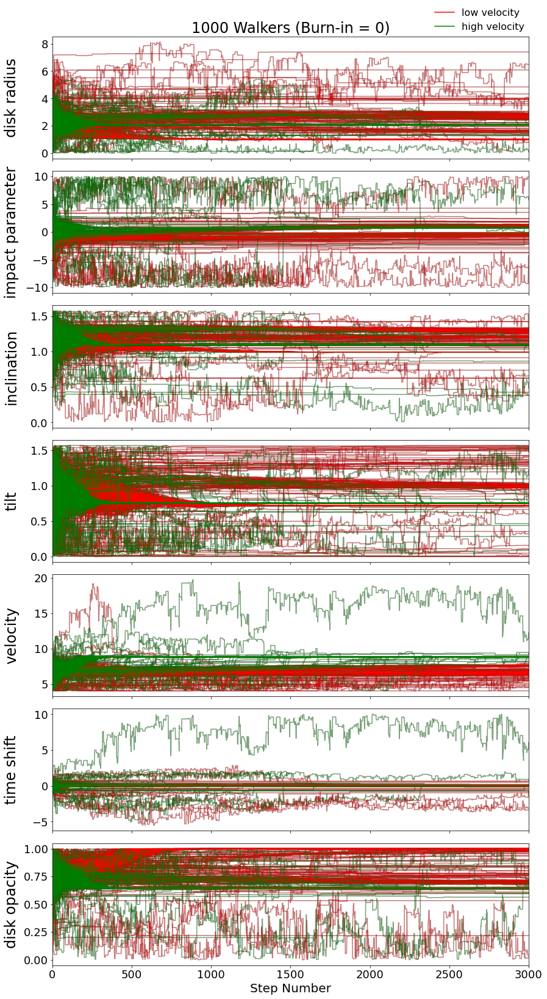

In [34]:
# extracting low and high velocity solutions for the translucent disk
vel_names_td = ['low velocity', 'high velocity']
lvel_td, hvel_td = mcmc.extract_solutions(sampler_td, [4, 4], [(0, 8), (8, 20)], 0, lbls_td, vel_names_td)

#### High Velocity Solutions for the Translucent Disk

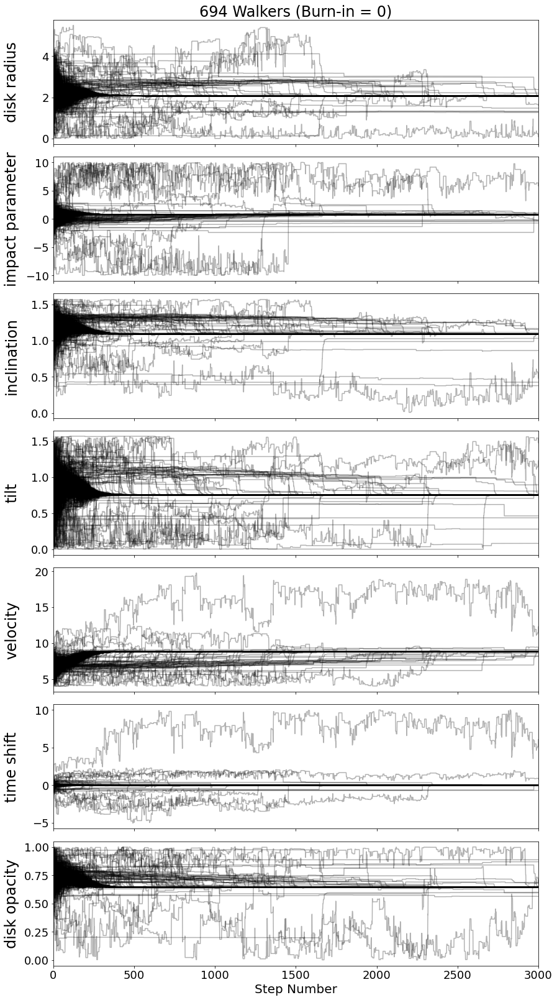

In [35]:
# plot the high velocity walkers for the translucent disk
mcmc.plot_walkers(hvel_td, lbls=lbls_td)

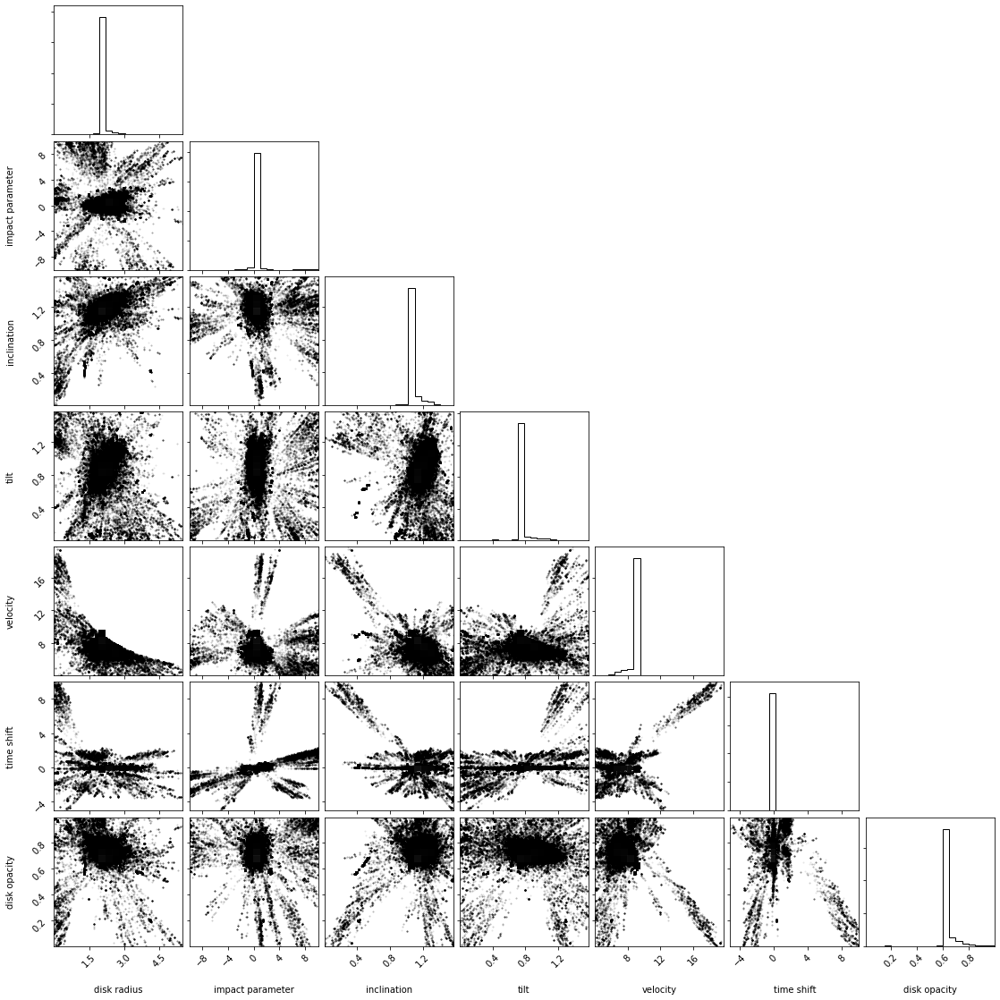

In [36]:
# plot the high velocity triangle for the translucent disk
mcmc.plot_triangle(hvel_td, lbls=lbls_td)

This clearly has but one solution.

100%|██████████| 500/500 [00:46<00:00, 10.64it/s]


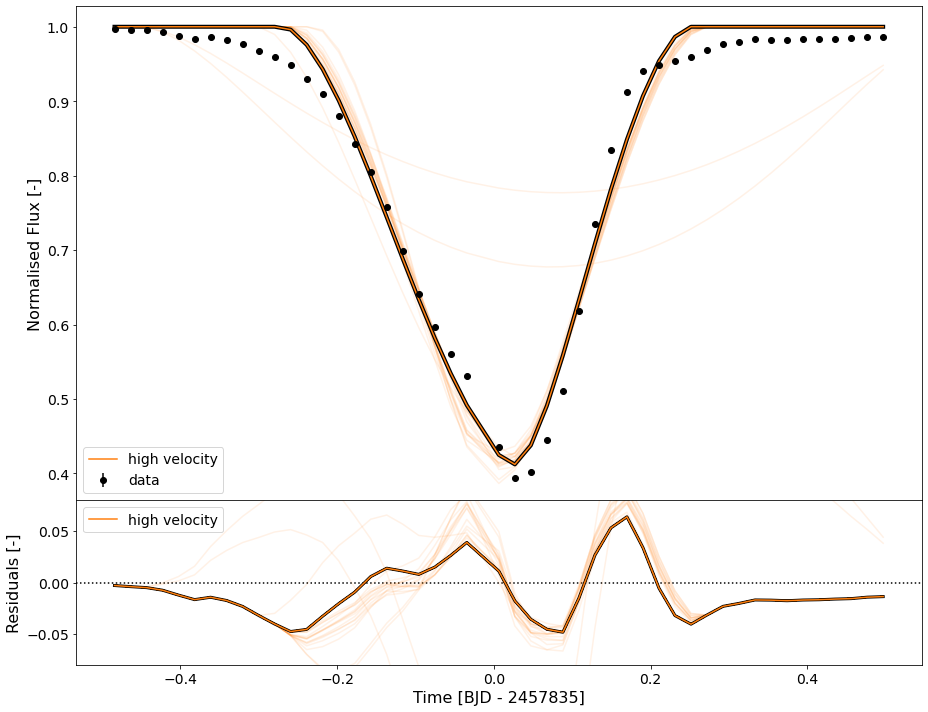

In [37]:
# determine the burn-in for the high velocity solutions for the translucent disk
cut_hvel_td = 500

# carry out statistics for the high velocity solutions for the translucent disk
stats_hvel_td, pb_hvel_td = mcmc.stats(hvel_td, cut=cut_hvel_td)

# plot the samples for the high velocity solutions for the translucent disk
_ = mcmc.plot_samples(time, flux, error, [translucent_disk], [hvel_td], ['high velocity'], cut_hvel_td, 500,
                      best_fit=True, dt=3002, residual_lims=(-0.08, 0.08))

In [38]:
# print the high velocity best fit parameters for the translucent disk
mcmc.print_parameters(pb_hvel_td, lbls_td, units_td)

disk radius        =     +2.071857     [R*]
impact parameter   =     +0.722407     [R*]
inclination        =     +62.47948     [deg]
tilt               =     +43.23963     [deg]
velocity           =     +8.826365     [R*/day]
time shift         =     -0.046670     [day]
disk opacity       =     +0.643868     [-]


#### Low Velocity Solutions for the Translucent Disk

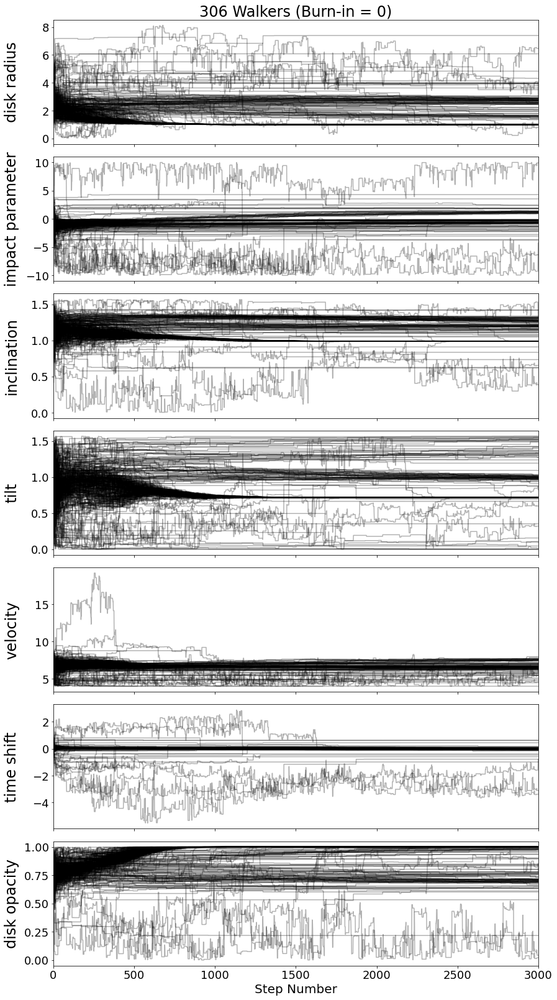

In [39]:
# plot the low velocity walkers for the translucent disk
mcmc.plot_walkers(lvel_td, lbls=lbls_td)

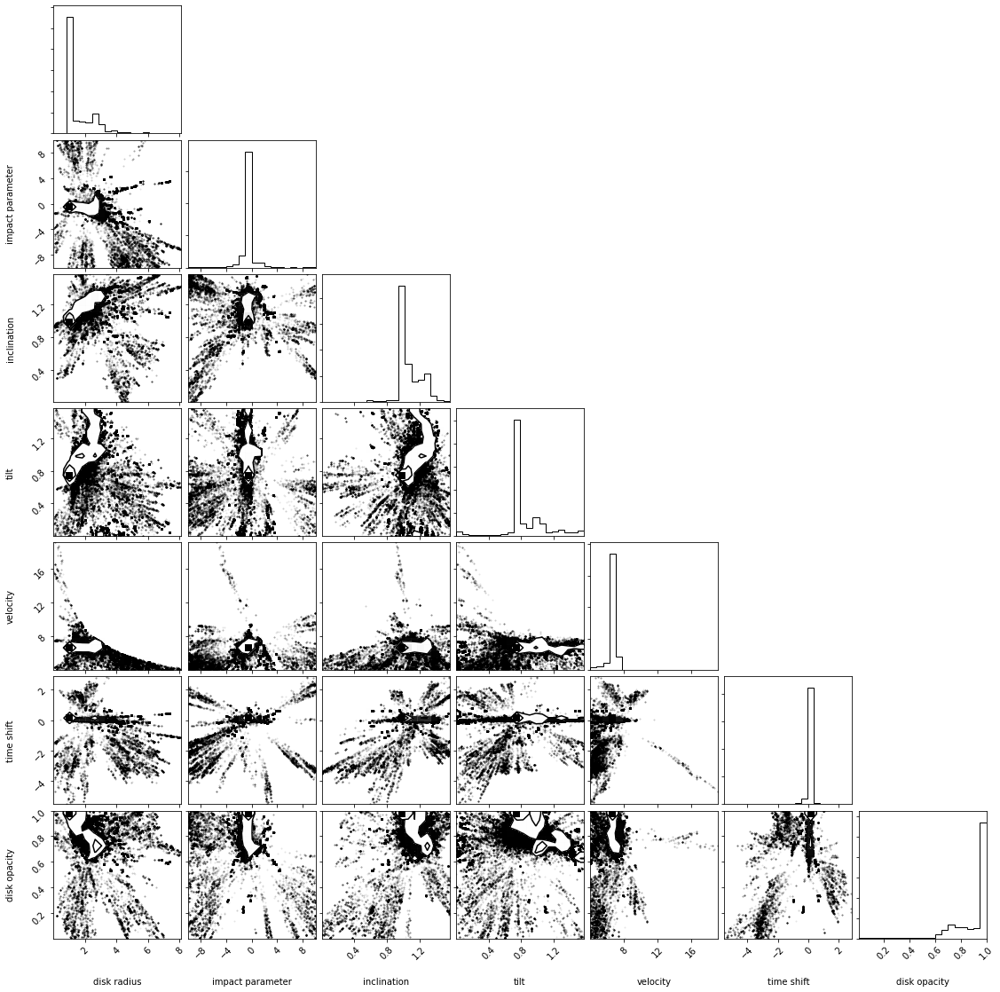

In [40]:
# plot the low velocity triangle for the translucent disk
mcmc.plot_triangle(lvel_td, lbls=lbls_td)

There is a sign of two solutions, which we can investigate. We see this in radius, inclination and tilt. As before we perform a radius split, as we are interested in small disks.

### Separating Low Velocity Solutions (Disk Radius) for the Translucent Disk

Here we extract the solutions with a disk radius above and below 2 $R_*$.

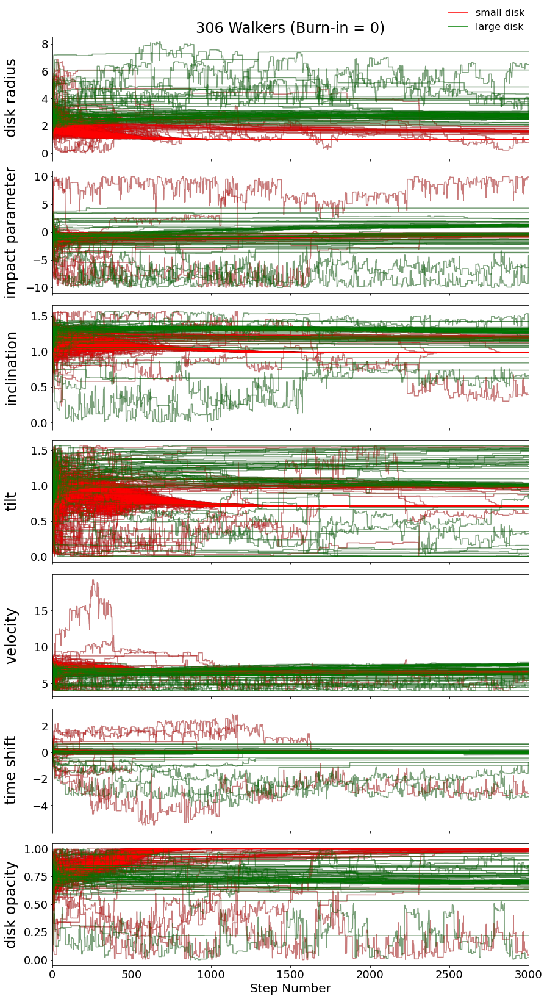

In [41]:
# extracting disk radius for the low velocity solutions of the translucent disk
dr_names_td = ['small disk', 'large disk']
ldr_td, hdr_td = mcmc.extract_solutions(lvel_td, [0, 0], [(0, 2), (2, 20)], 0, lbls_td, dr_names_td)

#### Low Velocity, High Disk Radii Solutions for the Translucent Disk

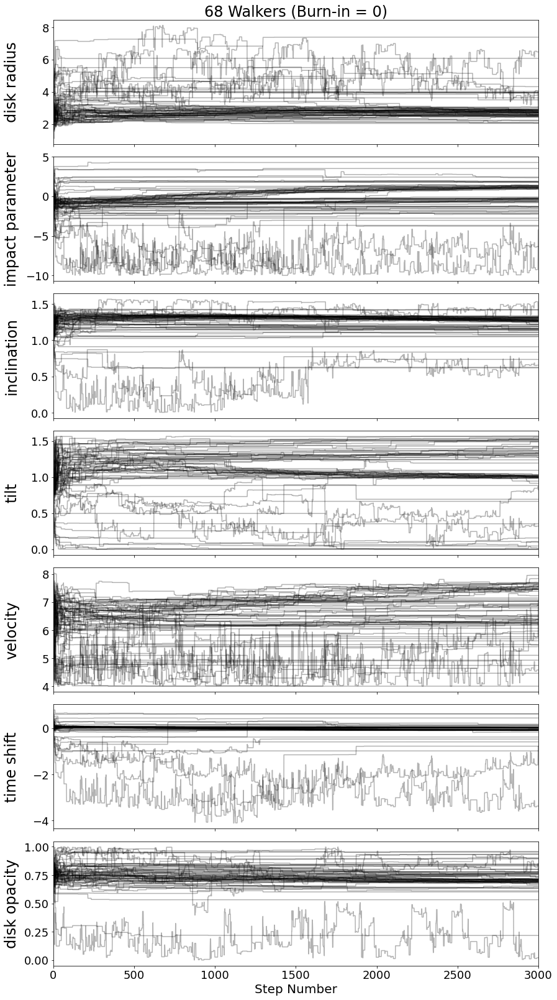

In [42]:
# plot the low velocity high disk radii walkers for the translucent disk
mcmc.plot_walkers(hdr_td, lbls=lbls_td)

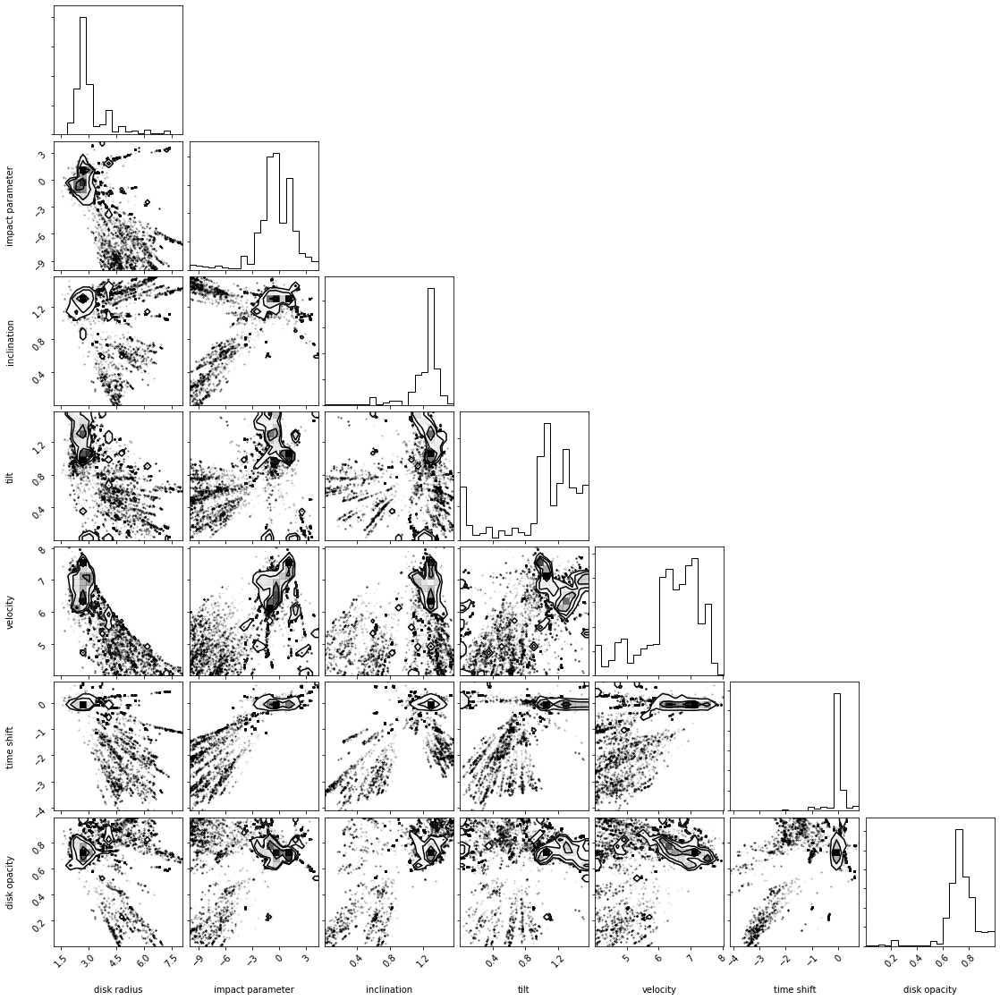

In [43]:
# plot the low velocity high disk radii solutions for the translucent disk
mcmc.plot_triangle(hdr_td, lbls=lbls_td)

We see no real solution, but that makes a lot of sense given that we have only 68 walkers. Note that this is less than 15% of the original sample. Due to this fact we scrap this solution.

# CHECK PB ON THIS AND DECIDE WHETHER TO EVEN CONSIDER IT

100%|██████████| 500/500 [00:30<00:00, 16.60it/s]


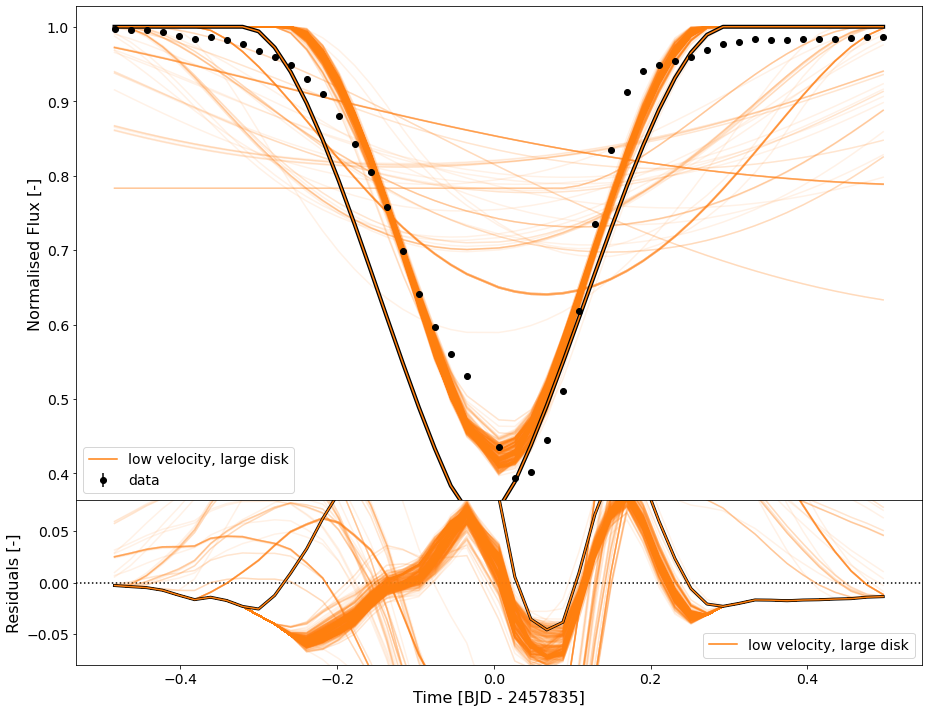

In [44]:
# determine burn-in for the low velocity high disk radii solutions for the translucent disk
cut_hdr_td = 1000

# carry out statistics for the low velocity high disk radii solutions for the translucent disk
stats_hdr_td, pb_hdr_td = mcmc.stats(hdr_td, cut=cut_hdr_td)

# plot samples for the low velocity high disk radii solutions for the translucent disk
_ = mcmc.plot_samples(time, flux, error, [translucent_disk], [hdr_td], ['low velocity, large disk'], cut_hdr_td,
                      500, best_fit=True, dt=3002, residual_lims=(-0.08, 0.08))

In [45]:
# print the best fit parameters for the low velocity high disk radii solutions for the translucent disk
mcmc.print_parameters(pb_hdr_td, lbls_td, units_td)

disk radius        =     +2.818071     [R*]
impact parameter   =     -0.283833     [R*]
inclination        =     +73.72978     [deg]
tilt               =     +61.16932     [deg]
velocity           =     +6.555087     [R*/day]
time shift         =     +0.007655     [day]
disk opacity       =     +0.721899     [-]


#### Low Velocity, Low Disk Radii Solutions for the Translucent Disk

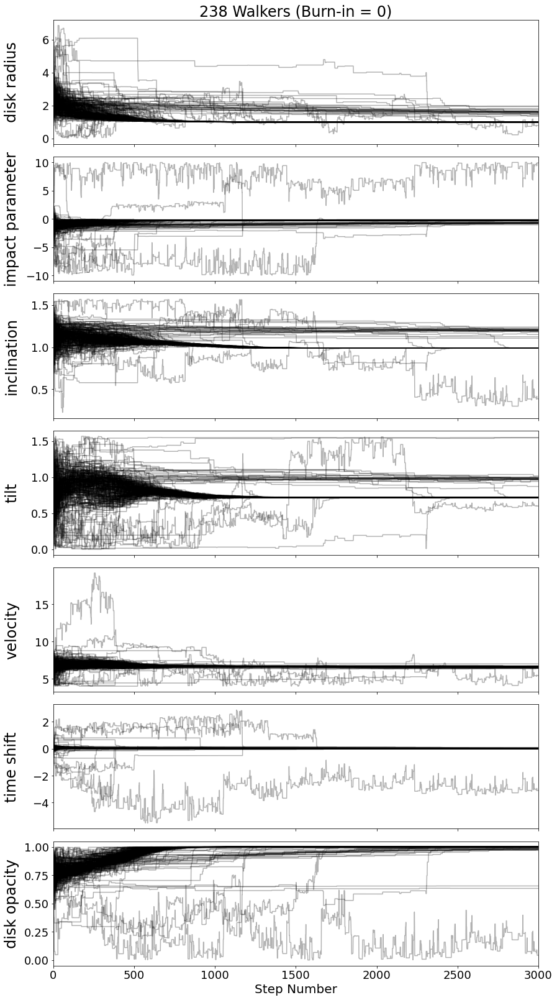

In [46]:
# plot the low velocity low disk radii walkers for the translucent disk
mcmc.plot_walkers(ldr_td, lbls=lbls_td)

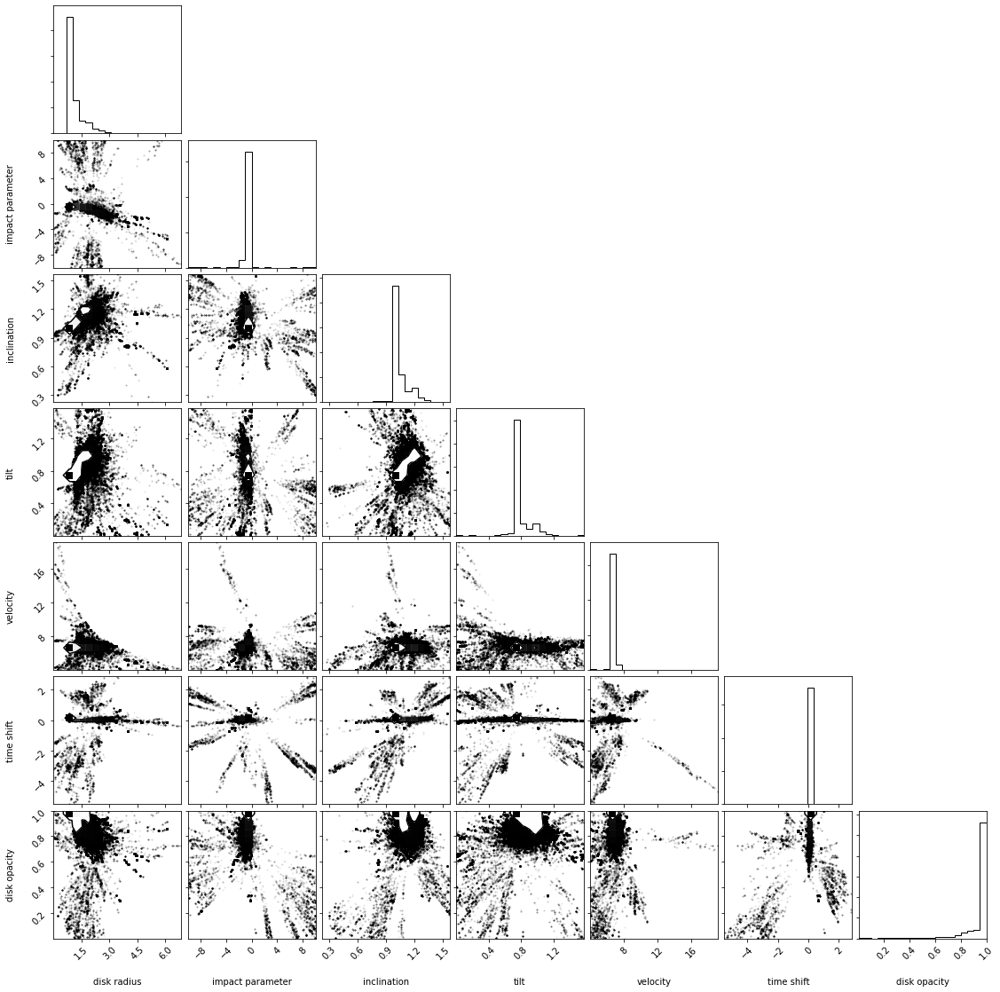

In [47]:
# plot the low velocity low disk radii triangle for the translucent disk
mcmc.plot_triangle(ldr_td, lbls=lbls_td)

Clearly one solution.

100%|██████████| 500/500 [00:42<00:00, 11.78it/s]


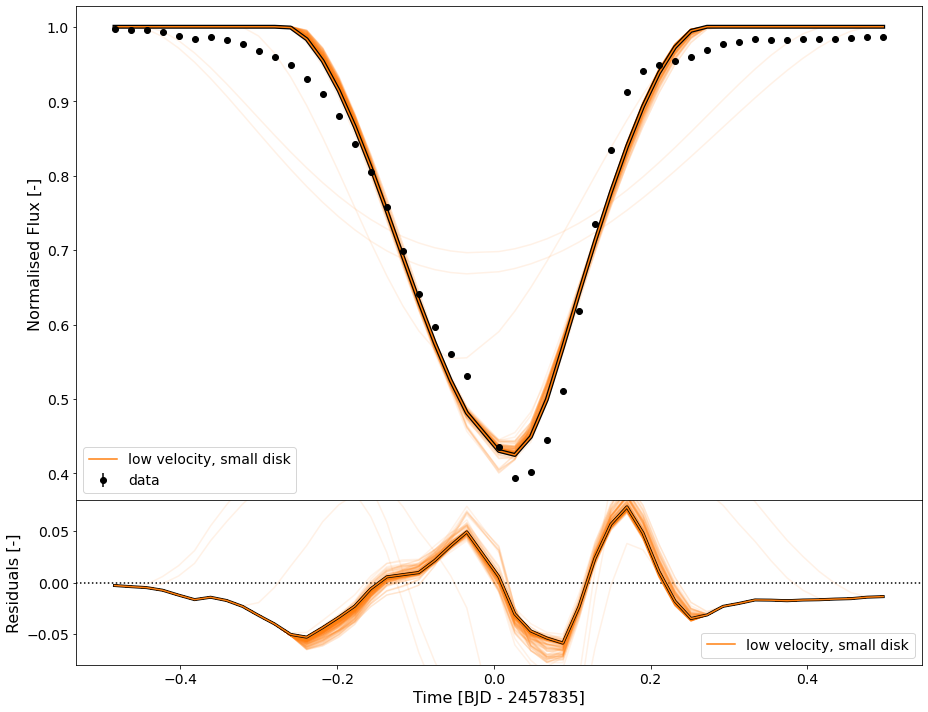

In [48]:
# determine the burn-in for the low velocity low disk radii solutions for the translucent disk
cut_ldr_td = 500

# carry out statistics for the low velocity low disk radii solutions for the translucent disk
stats_ldr_td, pb_ldr_td = mcmc.stats(ldr_td, cut=cut_ldr_td)

# plot the samples for the low velocity low disk radii solutions for the translucent disk
_ = mcmc.plot_samples(time, flux, error, [translucent_disk], [ldr_td], ['low velocity, small disk'], cut_ldr_td,
                      500, best_fit=True, dt=3002, residual_lims=(-0.08, 0.08))

In [49]:
# print the best fit parameters for the low velocity low disk radii solutions for the translucent disk
mcmc.print_parameters(pb_ldr_td, lbls_td, units_td)

disk radius        =     +0.992788     [R*]
impact parameter   =     -0.250574     [R*]
inclination        =     +56.80756     [deg]
tilt               =     +41.24993     [deg]
velocity           =     +6.637684     [R*/day]
time shift         =     +0.009910     [day]
disk opacity       =     +0.999996     [-]


### Compare Translucent Disk Solutions

Here we compare the translucent disk solutions discussed in the preceding sections

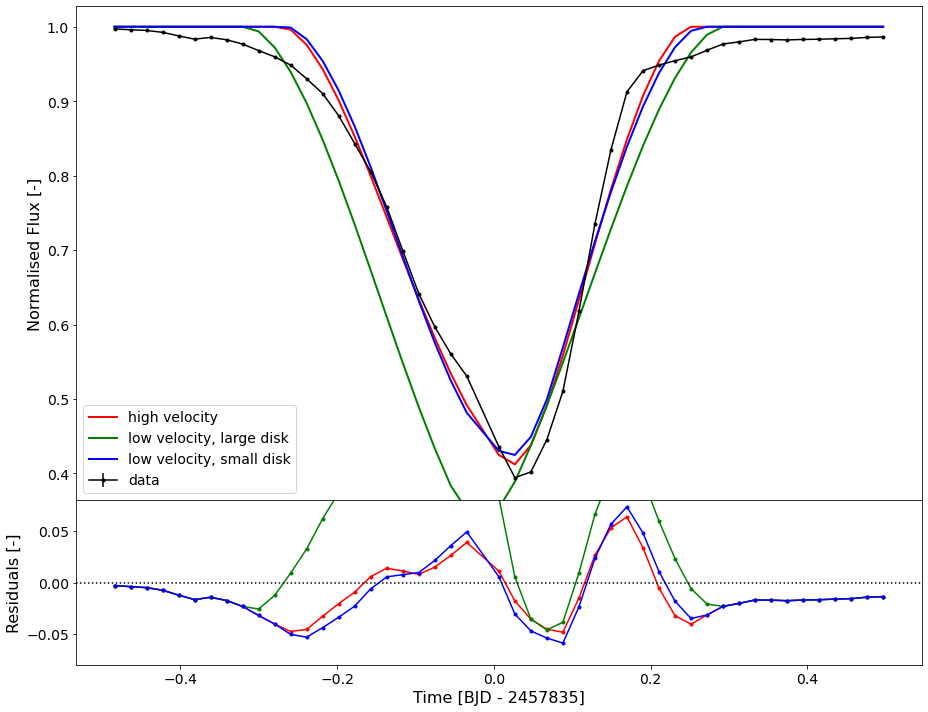

In [50]:
chi2s_td = mcmc.plot_models(time, flux, error, 3*[translucent_disk], [pb_hvel_td, pb_hdr_td, pb_ldr_td], 
                     ['high velocity', 'low velocity, large disk','low velocity, small disk'],
                     dt=3002, residual_lims=(-0.08, 0.08), lw=2)

In [51]:
print('chi2 for the translucent disk with high velocity is - %.6f' % chi2s_td[0])
print('chi2 for the translucent disk with low velocity, large disk is - %.6f' % chi2s_td[1])
print('chi2 for the translucent disk with low velocity, small disk is - %.6f' % chi2s_td[2])

chi2 for the translucent disk with high velocity is - 2753237.266559
chi2 for the translucent disk with low velocity, large disk is - 20705793.722417
chi2 for the translucent disk with low velocity, small disk is - 3540952.304685


## Compare Single Component Disks (Opaque and Translucent)

Here we compare the solutions for the Opaque Disk and the Translucent Disk

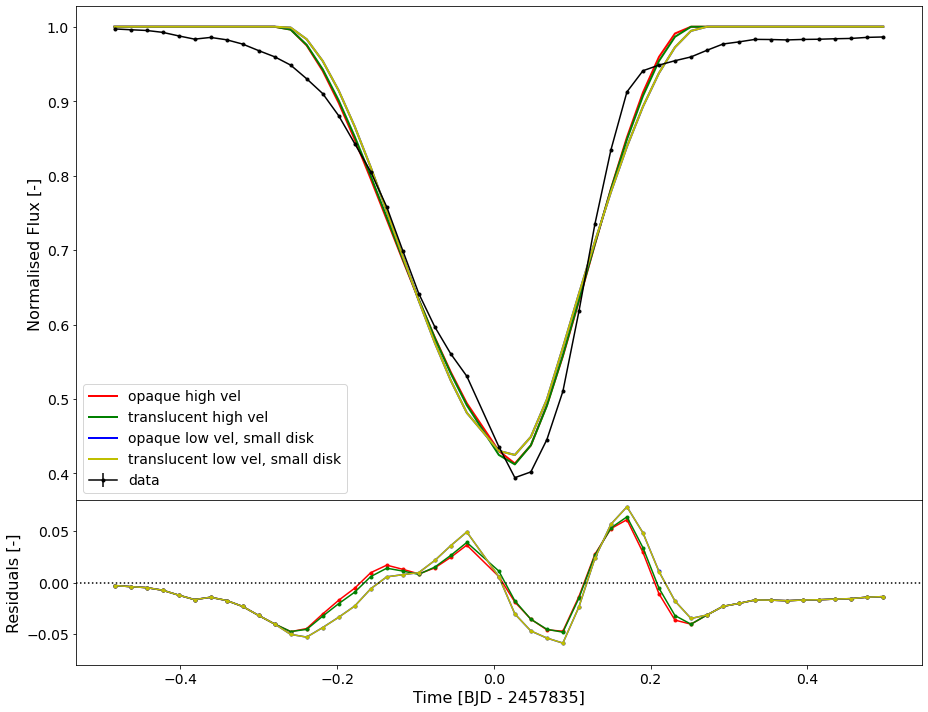

In [52]:
tod_mods = 2 * [opaque_disk, translucent_disk]
tod_lbls = ['opaque high vel', 'translucent high vel',
            'opaque low vel, small disk', 'translucent low vel, small disk']
tod_pbs  = [pb_hvel_od, pb_hvel_td, pb_ldr_od, pb_ldr_td]

tod_chi2 = mcmc.plot_models(time, flux, error, tod_mods, tod_pbs, tod_lbls, dt=3002, residual_lims=(-0.08, 0.08),
                            lw=2)

In [53]:
tod_disk  = 2 * ['opaque', 'translucent']
tod_type  = 2 * ['high velocity'] + 2 * ['low velocity, small disk']
tod_lbls  = 2 * [lbls_od, lbls_td]
tod_units = 2 * [units_od, units_td]


for disk, typ, pb, chi2, lbl, unit in zip(tod_disk, tod_type, tod_pbs, tod_chi2, tod_lbls, tod_units):
    #print(disk, typ, pb, chi2, lbl, unit)
    print('%s disk with %s' % (disk, typ))
    mcmc.print_parameters(pb, lbl, unit)
    print('chi2 = %.2f' % chi2)
    print('')

opaque disk with high velocity
disk radius        =     +1.939238     [R*]
impact parameter   =     +0.851913     [R*]
inclination        =     +67.11369     [deg]
tilt               =     +24.83339     [deg]
velocity           =     +9.135350     [R*/day]
time shift         =     -0.058551     [day]
chi2 = 2682623.11

translucent disk with high velocity
disk radius        =     +2.071857     [R*]
impact parameter   =     +0.722407     [R*]
inclination        =     +62.47948     [deg]
tilt               =     +43.23963     [deg]
velocity           =     +8.826365     [R*/day]
time shift         =     -0.046670     [day]
disk opacity       =     +0.643868     [-]
chi2 = 2753237.27

opaque disk with low velocity, small disk
disk radius        =     +0.992294     [R*]
impact parameter   =     -0.250570     [R*]
inclination        =     +56.78165     [deg]
tilt               =     +41.21967     [deg]
velocity           =     +6.636696     [R*/day]
time shift         =     +0.009899     [da

Interestingly enough the parameters are quite comparable for the high velocity and the low velocity solutions, but in both cases the opaque disk has a better goodness of fit. For this reason we adopt these values to be the solutions and save them in the models folder.

In [54]:
# saving the best fit models for the single component disks
np.save('models/best_fits/opaque_disk_high_velocity.npy', pb_hvel_od)
np.save('models/best_fits/opaque_disk_low_velocity_small_disk.npy', pb_ldr_od)

## Fuzzy Disk

The fuzzy disk is a two component disk model which is ended to have an opaque centre (as above) and then an extended edge that is expected to be relatively transparent.

In [55]:
# setting up labels, units and bounds for the fuzzy disk
lbls_fd = ['disk radius', 'edge thickness', 'impact parameter', 'inclination', 'tilt', 
           'velocity', 'time shift', 'disk opacity', 'edge opacity']
units_fd = ['R*', 'R*', 'R*', 'deg', 'deg', 'R*/day', 'day', '-', '-']
bounds_fd = [(rl, ru/2.), (rl, ru/2.), (bl/2., bu/2.), (iu/2., iu), (tl, tu), (vl, vu/2.), 
             (-0.5, 0.5), (Tu/2., Tu), (Tl, Tu/2.)]

# setting up intial guess for the fuzzy disk
args_fd = (9, 1000, bounds_fd)
p0_fd = eclipse.useful_p0(mcmc.bounded_p0, args_fd, fuzzy_disk, time, True, 5)


  1%|          | 7/1000 [00:00<00:14, 68.75it/s]

round 1 from 0 to 71 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 74.78it/s]

round 2 from 71 to 139 (max = 1000)


  1%|          | 7/1000 [00:00<00:15, 65.82it/s]

round 3 from 139 to 213 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 76.13it/s]

round 4 from 213 to 283 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 72.93it/s]

round 5 from 283 to 345 (max = 1000)


  1%|          | 7/1000 [00:00<00:16, 59.95it/s]

round 6 from 345 to 413 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 74.22it/s]

round 7 from 413 to 486 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 71.77it/s]

round 8 from 486 to 561 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 74.79it/s]

round 9 from 561 to 630 (max = 1000)


  1%|          | 7/1000 [00:00<00:14, 68.88it/s]

round 10 from 630 to 695 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 74.30it/s]

round 11 from 695 to 766 (max = 1000)


  1%|          | 7/1000 [00:00<00:14, 69.09it/s]

round 12 from 766 to 826 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 72.52it/s]

round 13 from 826 to 892 (max = 1000)


  1%|          | 8/1000 [00:00<00:13, 72.13it/s]

round 14 from 892 to 971 (max = 1000)


  0%|          | 1/1000 [00:00<02:19,  7.18it/s]

round 15 from 971 to 1000 (max = 1000)


  3%|▎         | 8/229 [00:00<00:03, 71.31it/s]

ran a for loop
USEFUL ROUND 1 FROM 0 TO 771 (MAX = 1000)



  3%|▎         | 8/229 [00:00<00:03, 69.75it/s]

round 1 from 0 to 9 (max = 229)


  3%|▎         | 8/229 [00:00<00:02, 75.48it/s]

round 2 from 9 to 25 (max = 229)


  3%|▎         | 8/229 [00:00<00:03, 72.61it/s]

round 3 from 25 to 47 (max = 229)


  3%|▎         | 8/229 [00:00<00:03, 72.29it/s]

round 4 from 47 to 58 (max = 229)


  3%|▎         | 8/229 [00:00<00:02, 76.54it/s]

round 5 from 58 to 71 (max = 229)


  3%|▎         | 8/229 [00:00<00:02, 74.92it/s]

round 6 from 71 to 90 (max = 229)


  3%|▎         | 8/229 [00:00<00:03, 71.81it/s]

round 7 from 90 to 107 (max = 229)


  3%|▎         | 8/229 [00:00<00:03, 71.98it/s]

round 8 from 107 to 120 (max = 229)


  3%|▎         | 8/229 [00:00<00:02, 76.47it/s]

round 9 from 120 to 135 (max = 229)


  3%|▎         | 8/229 [00:00<00:02, 74.44it/s]

round 10 from 135 to 147 (max = 229)


  3%|▎         | 7/229 [00:00<00:03, 66.07it/s]

round 11 from 147 to 164 (max = 229)


  3%|▎         | 8/229 [00:00<00:03, 70.13it/s]

round 12 from 164 to 175 (max = 229)


  3%|▎         | 7/229 [00:00<00:03, 69.47it/s]

round 13 from 175 to 189 (max = 229)


  3%|▎         | 8/229 [00:00<00:02, 74.18it/s]

round 14 from 189 to 202 (max = 229)


  3%|▎         | 8/229 [00:00<00:02, 75.47it/s]

round 15 from 202 to 219 (max = 229)


  1%|          | 2/229 [00:00<00:20, 11.07it/s]

round 16 from 219 to 229 (max = 229)


 16%|█▌        | 8/51 [00:00<00:00, 71.26it/s]

ran a for loop
USEFUL ROUND 2 FROM 771 TO 949 (MAX = 1000)



 16%|█▌        | 8/51 [00:00<00:00, 71.24it/s]

round 1 from 0 to 4 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 69.54it/s]

round 2 from 4 to 7 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 77.87it/s]

round 3 from 7 to 12 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 76.14it/s]

round 4 from 12 to 19 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 74.29it/s]

round 5 from 19 to 23 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 79.88it/s]

round 6 from 23 to 29 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 79.87it/s]

round 7 from 29 to 34 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 75.49it/s]

round 8 from 34 to 39 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 72.02it/s]

round 9 from 39 to 43 (max = 51)


 16%|█▌        | 8/51 [00:00<00:00, 74.96it/s]

round 10 from 43 to 48 (max = 51)


  2%|▏         | 1/51 [00:00<00:05,  8.59it/s]

round 11 from 48 to 51 (max = 51)


  0%|          | 0/10 [00:00<?, ?it/s]

ran a for loop
USEFUL ROUND 3 FROM 949 TO 990 (MAX = 1000)

round 1 from 0 to 1 (max = 10)


  0%|          | 0/10 [00:00<?, ?it/s]

round 2 from 1 to 5 (max = 10)


  0%|          | 0/10 [00:00<?, ?it/s]

round 3 from 5 to 7 (max = 10)
round 4 from 7 to 8 (max = 10)


  0%|          | 0/10 [00:00<?, ?it/s]

round 5 from 8 to 9 (max = 10)
round 6 from 9 to 10 (max = 10)


  0%|          | 0/3 [00:00<?, ?it/s]

ran a for loop
USEFUL ROUND 4 FROM 990 TO 997 (MAX = 1000)



  0%|          | 0/3 [00:00<?, ?it/s]

round 1 from 0 to 1 (max = 3)


  0%|          | 0/3 [00:00<?, ?it/s]

round 2 from 1 to 2 (max = 3)
round 3 from 2 to 3 (max = 3)


 67%|██████▋   | 2/3 [00:00<00:00,  3.95it/s]

ran a for loop
USEFUL ROUND 5 FROM 997 TO 1000 (MAX = 1000)



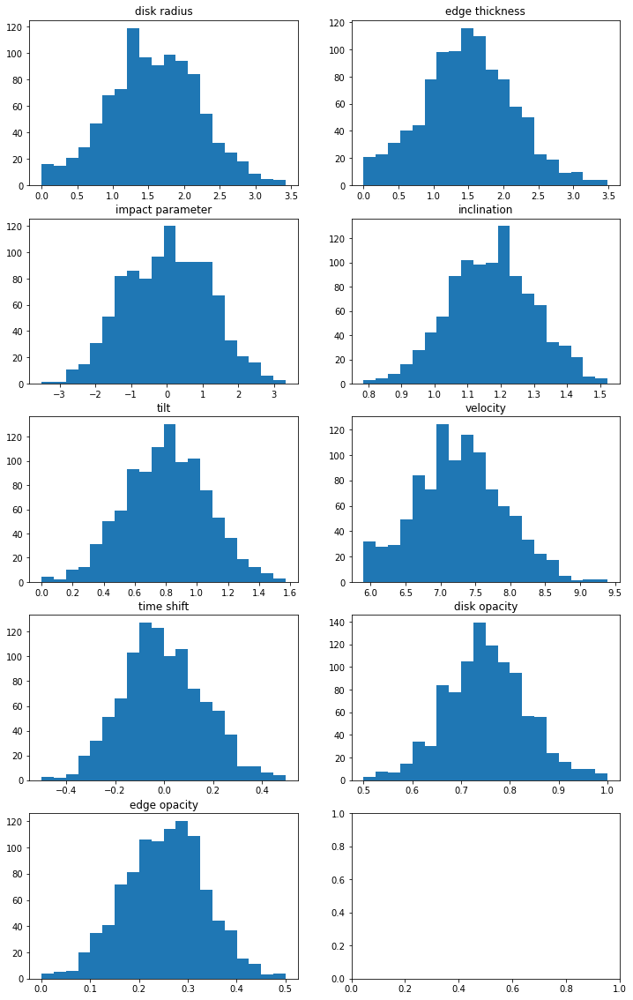

In [59]:
mcmc.plot_hist(p0_fd, lbls_fd)

In [155]:
# mcmc parameters for the fuzzy disk
be_fd = 'models/mcmc_backends/fuzzy_disk_new.h5'
mcmc_args_fd = (time, flux, error, fuzzy_disk, fuzzy_prior)
BE_fd = emcee.backends.HDFBackend(be_fd)

# run mcmc for the fuzzy disk
p_fd, sampler_fd = mcmc.run_mcmc(*mcmc_args_fd, p0_fd, 2500-1316, reset=False, savename=be_fd)

# load mcmc for the fuzzy disk
sampler_fd = emcee.EnsembleSampler(1000, 9, mcmc.lnprob, args=mcmc_args_fd, backend=BE_fd)

100%|██████████| 1184/1184 [24:22:37<00:00, 74.12s/it]  


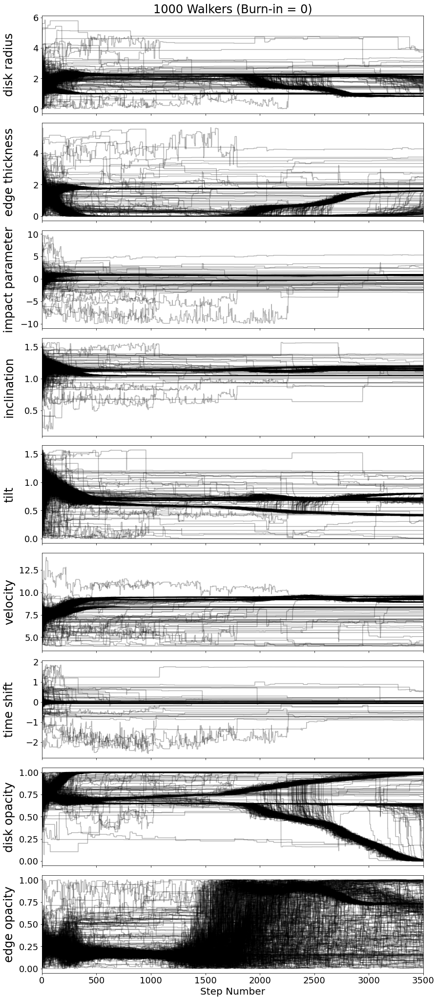

In [156]:
# plot the walkers for the fuzzy disk
mcmc.plot_walkers(sampler_fd, lbls=lbls_fd)

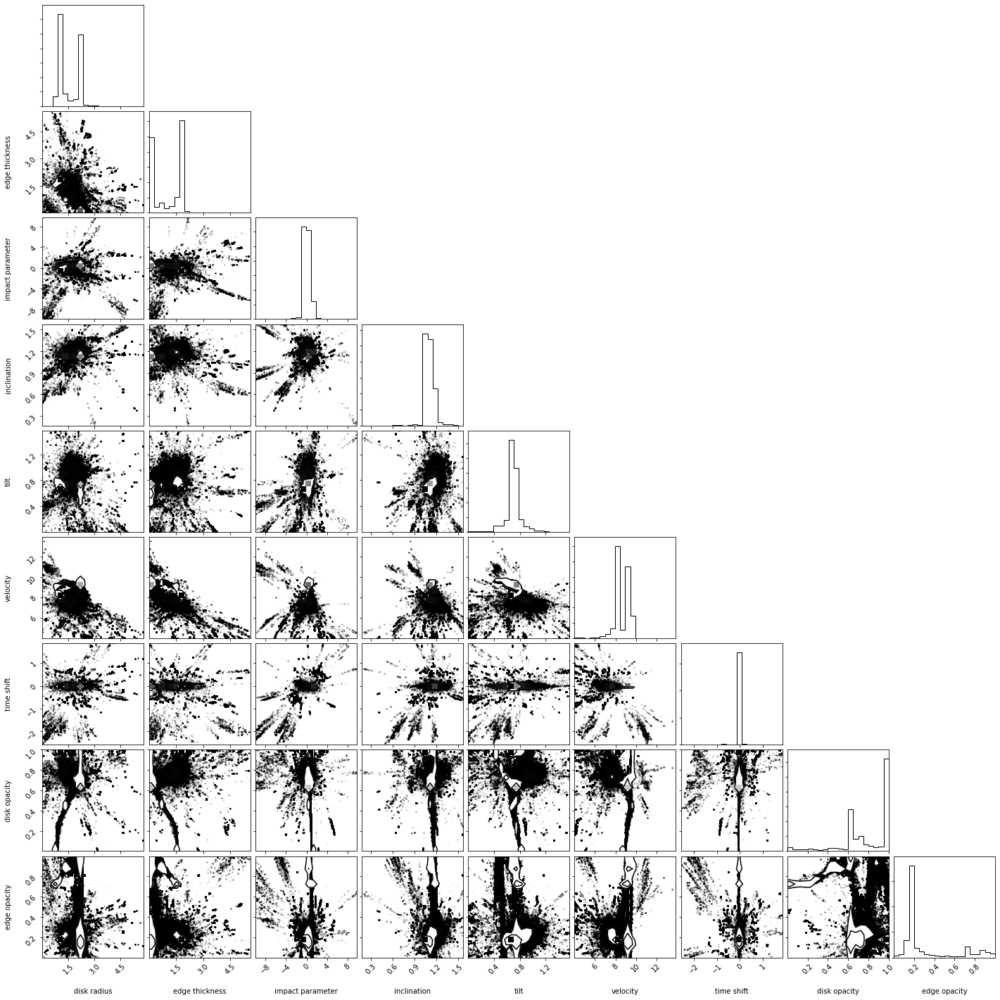

In [157]:
# plot the triangle for the fuzzy disk
mcmc.plot_triangle(sampler_fd, lbls=lbls_fd)

There are quite a couple of splits here: disk radius, edge thickness, tilt, disk opacity have two peaks, velocity has a small second peak, and edge opacity has 3 peaks. Note the location of the edge opacity peaks though. One is around 0 (i.e. no edge), and one is around 1 (which is simply a single component disk with total radius of disk radius + edge thickness). For this reason we start with exploring the edge opacity.

### Extracting Solutions (Edge Opacity) for the Fuzzy Disk

Here we extract solutions with an edge opacity from 0.0$-$0.1, 0.1$-$0.4, and 0.4$-$1.0.

In [ ]:
# extracting disk opacity radius for the fuzzy disk
do_names_fd = ['translucent', 'opaque']
dol_fd, doh_fd,  = mcmc.extract_solutions(sampler_fd, [-2, -2], [(0, 0.9), (0.9, 1.0)],
                                                0, lbls_fd, do_names_fd)

1) Opaque Disk solutions
Have lower velocities and Disk radii (which seems obvious)

2) Translucent Disk solutions
Have higher velocities smaller edge thicknesses and larger disk radii (as if just a larger translucent disk)

#### Opaque Solutions for the Fuzzy Disk

In [ ]:
# plot the opaque walkers for the fuzzy disk
mcmc.plot_walkers(doh_fd, 0, lbls_fd)

In [ ]:
# plot the opaque triangle for the fuzzy disk
mcmc.plot_triangle(doh_fd, lbls=lbls_fd)

Clearly just one solution.

100%|██████████| 500/500 [01:28<00:00,  5.64it/s]


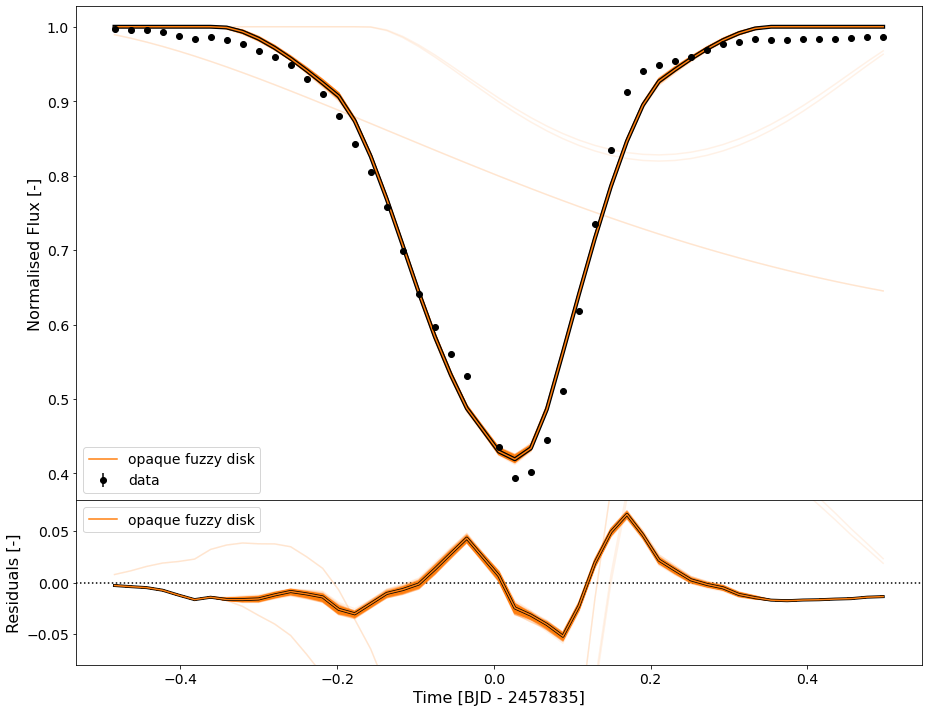

In [74]:
# determine burn-in for the opaque solutions for the fuzzy disk
cut_doh_fd = 350

# carry out statistics for the opaque solutions for the fuzzy disk
stats_doh_fd, pb_doh_fd = mcmc.stats(doh_fd, cut=cut_doh_fd)

# plot the samples for the opaque solutions for the fuzzy disk
_ = mcmc.plot_samples(time, flux, error, [fuzzy_disk], [doh_fd], ['opaque fuzzy disk'], cut_doh_fd, 500, 
                 best_fit=True, dt=3002, residual_lims=(-0.08,0.08))

In [75]:
# print the best-fit parameters for the translucent solutions for the fuzzy disk
mcmc.print_parameters(pb_doh_fd, lbls_fd, units_fd)

disk radius        =     +1.001669     [R*]
edge thickness     =     +1.781314     [R*]
impact parameter   =     -0.317056     [R*]
inclination        =     +61.05232     [deg]
tilt               =     +43.68275     [deg]
velocity           =     +8.179997     [R*/day]
time shift         =     +0.017907     [day]
disk opacity       =     +0.996586     [-]
edge opacity       =     +0.162823     [-]


#### Translucent Solutions for the Fuzzy Disk

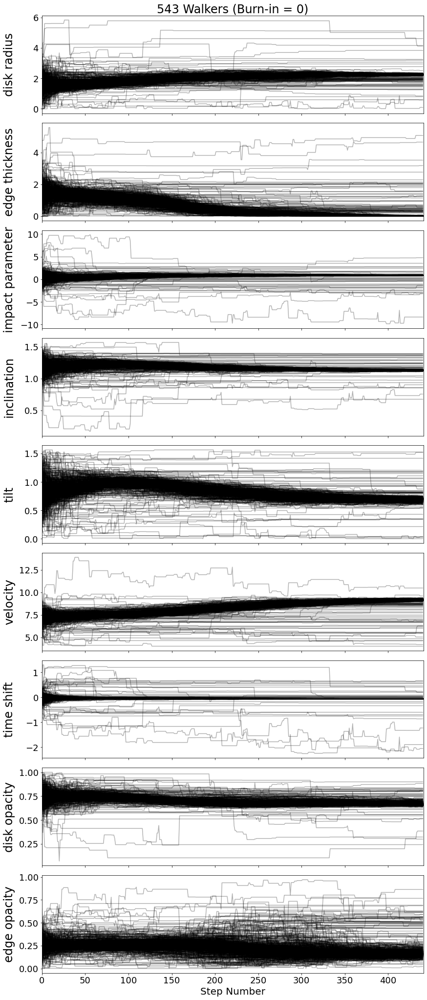

In [76]:
# plot the translucent walkers for the fuzzy disk
mcmc.plot_walkers(dol_fd, 0, lbls_fd)

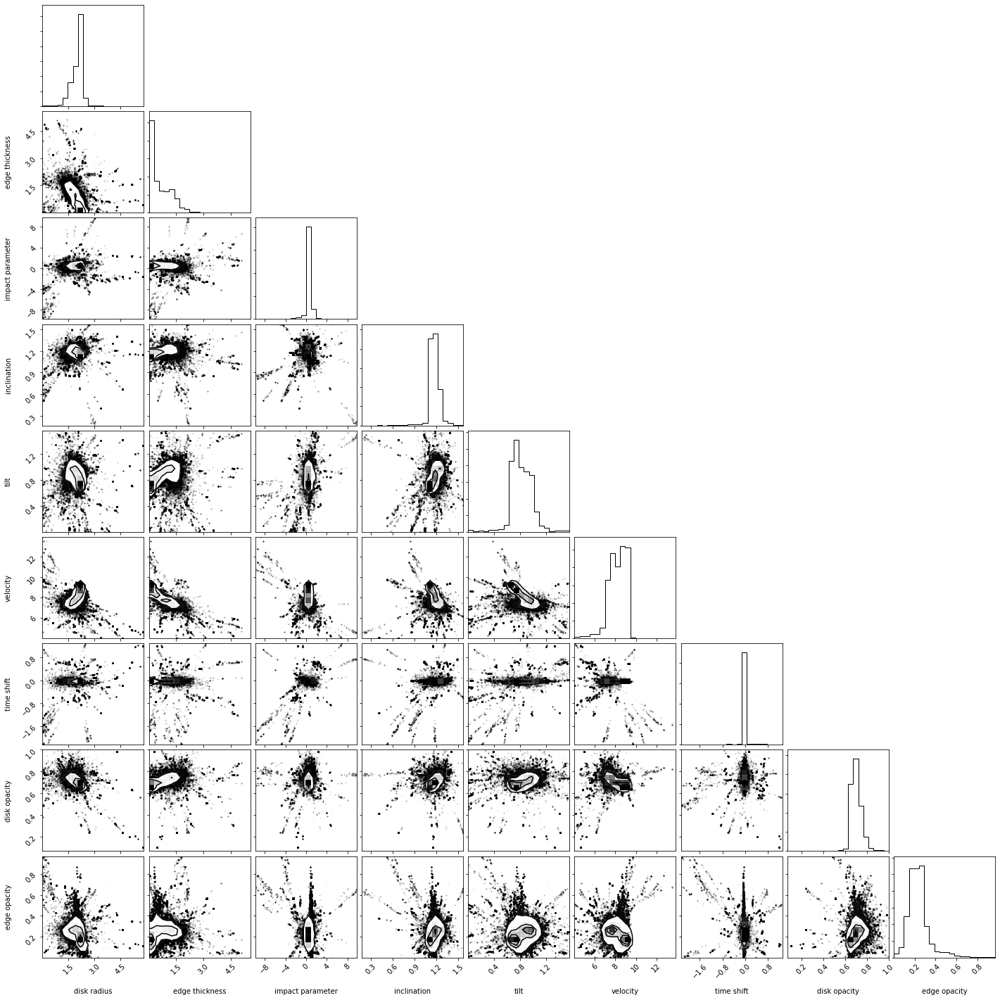

In [77]:
# plot the translucent triangle for the fuzzy disk
mcmc.plot_triangle(dol_fd, 0, lbls_fd)

Clearly one solution, so we observe this one too.

100%|██████████| 500/500 [01:34<00:00,  5.31it/s]


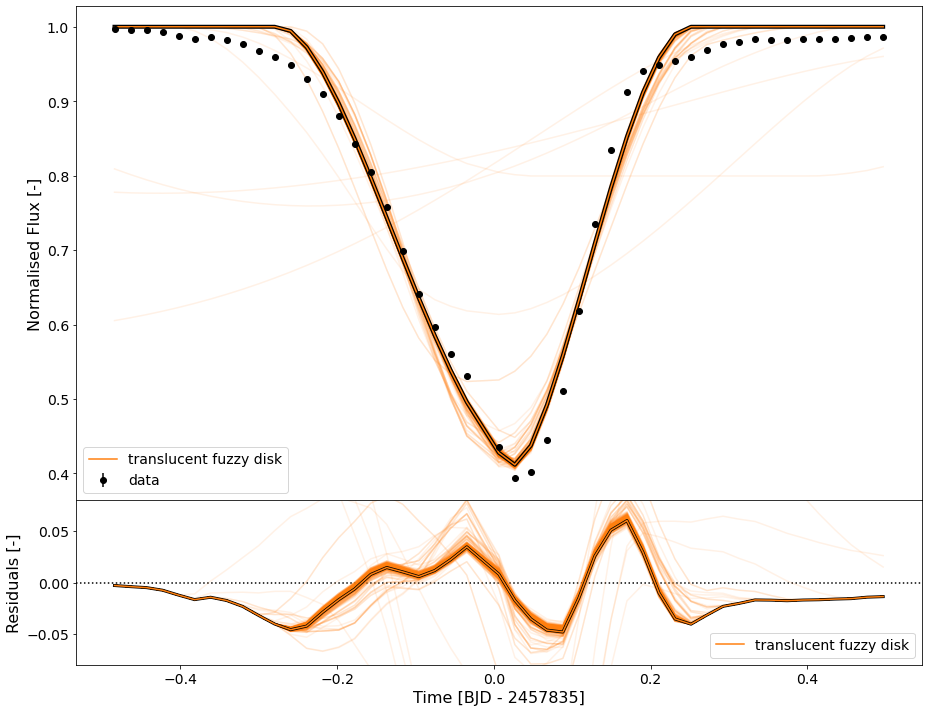

In [78]:
# determine burn-in for the translucent solutions for the fuzzy disk
cut_dol_fd = 350

# carry out statistics for the translucent solutions for the fuzzy disk
stats_dol_fd, pb_dol_fd = mcmc.stats(dol_fd, cut=cut_dol_fd)

# plot the samples for the translucent solutions for the fuzzy disk
_ = mcmc.plot_samples(time, flux, error, [fuzzy_disk], [dol_fd], ['translucent fuzzy disk'], cut_dol_fd, 500, 
                 best_fit=True, dt=3002, residual_lims=(-0.08,0.08))

In [79]:
# print the best fit parameters for the translucent solutions for the fuzzy disk
mcmc.print_parameters(pb_dol_fd, lbls_fd, units_fd)

disk radius        =     +2.248063     [R*]
edge thickness     =     +0.041985     [R*]
impact parameter   =     +0.866985     [R*]
inclination        =     +65.02804     [deg]
tilt               =     +40.11106     [deg]
velocity           =     +9.083532     [R*/day]
time shift         =     -0.062887     [day]
disk opacity       =     +0.671705     [-]
edge opacity       =     +0.168664     [-]


### Compare Fuzzy Disk Solutions

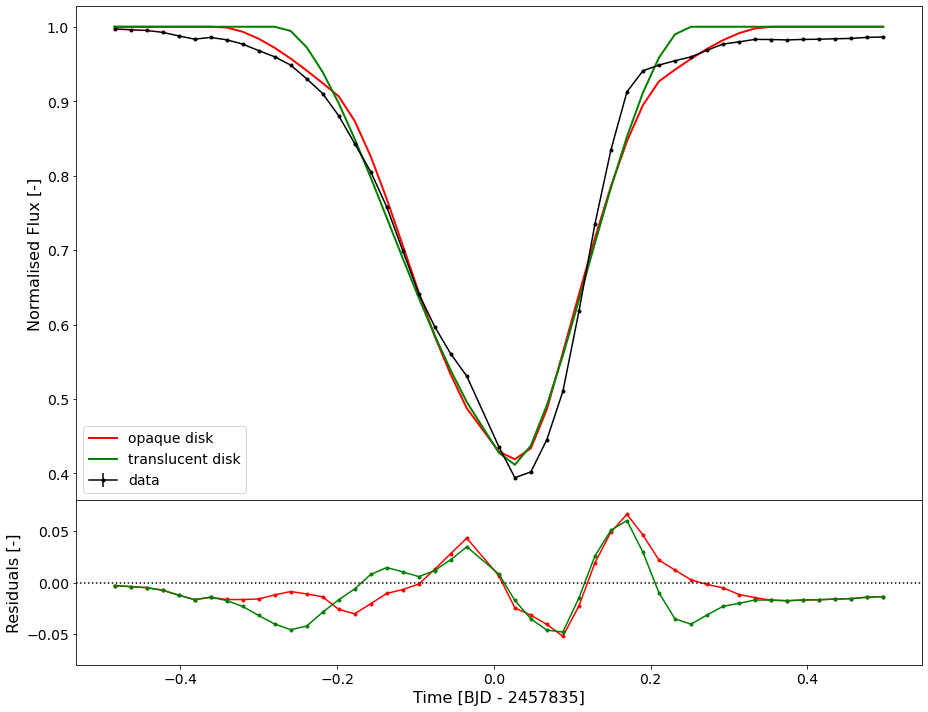

In [80]:
chi2s_fd = mcmc.plot_models(time, flux, error, 2*[fuzzy_disk], [pb_doh_fd, pb_dol_fd], 
                     ['opaque disk', 'translucent disk'], dt=3002, residual_lims=(-0.08, 0.08), lw=2)

In [81]:
print('chi2 for the fuzzy disk with an opaque disk is     - %.6f' % chi2s_fd[0])
print('chi2 for the fuzzy disk with a translucent disk is - %.6f' % chi2s_fd[1])

chi2 for the fuzzy disk with an opaque disk is     - 2041840.586499
chi2 for the fuzzy disk with a translucent disk is - 2577512.724554


## Compare All Disk Models

Here we compare all the disk models we've tested against each other and present the results below.

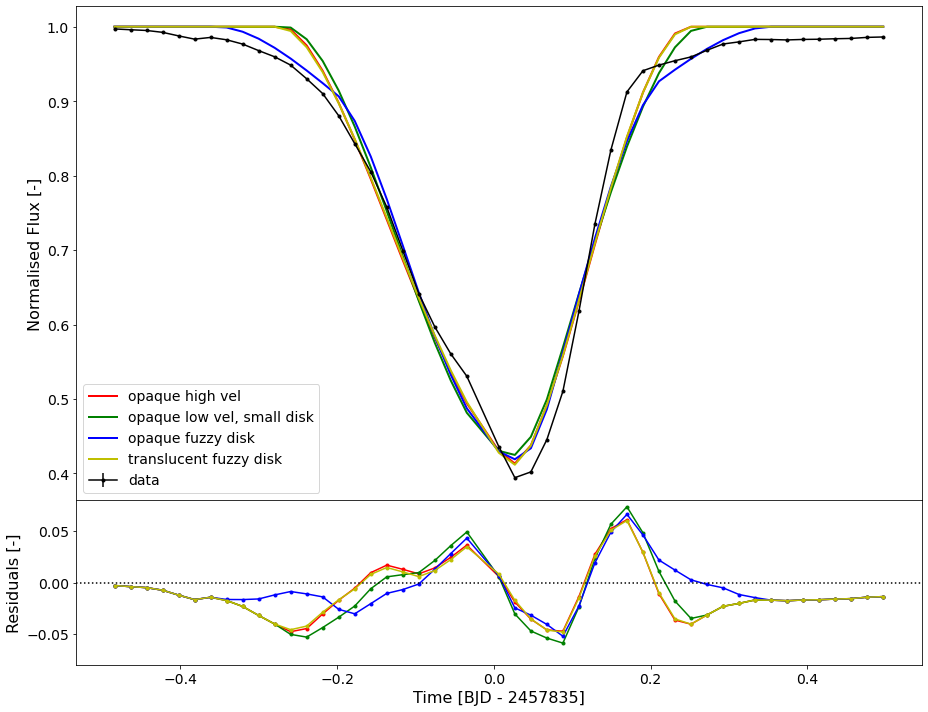

In [82]:
all_mods = 2 * [opaque_disk] + 2 * [fuzzy_disk]
all_lbls = ['opaque high vel', 'opaque low vel, small disk', 
            'opaque fuzzy disk', 'translucent fuzzy disk']
all_pbs  = [pb_hvel_od, pb_ldr_od, pb_doh_fd, pb_dol_fd]

all_chi2 = mcmc.plot_models(time, flux, error, all_mods, all_pbs, all_lbls, dt=3002, 
                            residual_lims=(-0.08, 0.08), lw=2)

In [84]:
all_disk  = 2 * ['opaque'] + 2 * ['fuzzy']
all_type  = ['high velocity', 'low velocity, small disk', 'opaque disk', 'translucent disk']
all_lbls  = 2 * [lbls_od] + 2 * [lbls_fd]
all_units = 2 * [units_od] + 2 * [units_fd]


for disk, typ, pb, chi2, lbl, unit in zip(all_disk, all_type, all_pbs, all_chi2, all_lbls, all_units):
    #print(disk, typ, pb, chi2, lbl, unit)
    print('%s disk with %s' % (disk, typ))
    mcmc.print_parameters(pb, lbl, unit)
    print('chi2 = %.2f' % chi2)
    print('')

opaque disk with high velocity
disk radius        =     +1.939238     [R*]
impact parameter   =     +0.851913     [R*]
inclination        =     +67.11369     [deg]
tilt               =     +24.83339     [deg]
velocity           =     +9.135350     [R*/day]
time shift         =     -0.058551     [day]
chi2 = 2682623.11

opaque disk with low velocity, small disk
disk radius        =     +0.992294     [R*]
impact parameter   =     -0.250570     [R*]
inclination        =     +56.78165     [deg]
tilt               =     +41.21967     [deg]
velocity           =     +6.636696     [R*/day]
time shift         =     +0.009899     [day]
chi2 = 3540937.09

fuzzy disk with opaque disk
disk radius        =     +1.001669     [R*]
edge thickness     =     +1.781314     [R*]
impact parameter   =     -0.317056     [R*]
inclination        =     +61.05232     [deg]
tilt               =     +43.68275     [deg]
velocity           =     +8.179997     [R*/day]
time shift         =     +0.017907     [day]
disk

Here we also save the two fuzzy disk models.

In [85]:
# saving the best fit models for the fuzzy disks
np.save('models/best_fits/fuzzy_opaque_disk.npy', pb_doh_fd)
np.save('models/best_fits/fuzzy_translucent_disk.npy', pb_dol_fd)

In [110]:
stats_doh_fd

array([[ 1.00166862e+00,  1.65860753e-02,  1.16744558e-02],
       [ 1.78131420e+00,  2.60808778e-02,  2.70924767e-02],
       [-3.17056366e-01,  1.04031980e-02,  1.09527473e-02],
       [ 1.06556400e+00,  1.27969600e-02,  9.79292520e-03],
       [ 7.62407786e-01,  2.75989557e-02,  2.78688037e-02],
       [ 8.17999738e+00,  8.03314562e-02,  9.71939002e-02],
       [ 1.79068020e-02,  9.15383135e-04,  7.75291649e-04],
       [ 9.96585892e-01,  1.98500820e-03,  2.66091400e-03],
       [ 1.62823362e-01,  4.98967519e-03,  5.10635014e-03]])

In [148]:
def latex_table_data(stats):
    names = ['$R_d$ [$R_*$]', '$t_e$ [$R_*$]', 'b [$R_*$]', '$i$ [$^\circ$]', '$\phi$ [$^\circ$]', 
             '$v_t$ [$R_*\,\mathrm{day}^{-1}$]', '$v_{t,A}$ [$\mathrm{km s}^-1$]', 
             '$v_{t,B}$ [$\mathrm{km s}^-1$]', '$\delta t$ [$\mathrm{day}$]', '$\tau$ [-]', '%\tau_e$ [-]']
    rd = te = b = i = phi = vt = vta = vtb = dt = tau = taue = ''
    strs = [rd, te, b, i, phi, vt, vta, vtb, dt, tau, taue]
    for x, stat in enumerate(stats):
        s = np.zeros((11,3))
        if len(stat) == 6:
            s[[0,2,3,4,5,8],:] = stat
            s[9,0] = 1
            s[6,:] = stat[4,:]
            s[7,:] = stat[4,:]
        else:
            s[[0,1,2,3,4,5,8,9,10],:]=stat
            s[6,:] = stat[5,:]
            s[7,:] = stat[5,:]
        for j in range(len(s)):
            par = s[j,0]
            unc = np.amax(s[j,1:])
            if (j == 3) or (j == 4):
                par = np.rad2deg(par)
                unc = np.rad2deg(unc)
            if j == 6:
                par = ((par * 1.376*u.Rsun/u.day).to(u.km/u.s)).value
                unc = ((unc * 1.376*u.Rsun/u.day).to(u.km/u.s)).value
            if j == 7:
                par = ((par * 1.296*u.Rsun/u.day).to(u.km/u.s)).value
                unc = ((unc * 1.296*u.Rsun/u.day).to(u.km/u.s)).value
            if par == 0:
                strs[j] = strs[j] + '&   $-$   '
            else:
                strs[j] = strs[j] + '& %.4f $\pm$ %.4f ' % (par, unc)
    for j in range(len(strs)):
        strs[j] = '%s %s \\' % (names[j], strs[j])
        print(strs[j])
    return strs

In [149]:
tabdat = latex_table_data([stats_hvel_od, stats_ldr_od, stats_doh_fd, stats_dol_fd])

$R_d$ [$R_*$] & 1.9392 $\pm$ 0.0005 & 0.9923 $\pm$ 0.0005 & 1.0017 $\pm$ 0.0166 & 2.2481 $\pm$ 0.0569  \
$t_e$ [$R_*$] &   $-$   &   $-$   & 1.7813 $\pm$ 0.0271 & 0.0420 $\pm$ 0.0599  \
b [$R_*$] & 0.8519 $\pm$ 0.0007 & -0.2506 $\pm$ 0.0002 & -0.3171 $\pm$ 0.0110 & 0.8670 $\pm$ 0.0370  \
$i$ [$^\circ$] & 67.1137 $\pm$ 0.0141 & 56.7817 $\pm$ 0.0262 & 61.0523 $\pm$ 0.7332 & 65.0280 $\pm$ 0.5133  \
$\phi$ [$^\circ$] & 24.8334 $\pm$ 0.0195 & 41.2197 $\pm$ 0.0496 & 43.6827 $\pm$ 1.5968 & 40.1111 $\pm$ 2.0370  \
$v_t$ [$R_*\,\mathrm{day}^{-1}] & 9.1354 $\pm$ 0.0013 & 6.6367 $\pm$ 0.0018 & 8.1800 $\pm$ 0.0972 & 9.0835 $\pm$ 0.1628  \
$v_{t,A}$ [$\mathrm{km s}^-1$] & 101.2166 $\pm$ 0.0149 & 73.5324 $\pm$ 0.0199 & 90.6316 $\pm$ 1.0769 & 100.6425 $\pm$ 1.8037  \
$v_{t,B}$ [$\mathrm{km s}^-1$] & 95.3319 $\pm$ 0.0140 & 69.2572 $\pm$ 0.0187 & 85.3624 $\pm$ 1.0143 & 94.7912 $\pm$ 1.6988  \
$\delta t$ [$\mathrm{day}$] & -0.0586 $\pm$ 0.0001 & 0.0099 $\pm$ 0.0000 & 0.0179 $\pm$ 0.0009 & -0.0629 $\pm$ 

In [135]:
print(tabdat)

['&   1.9392 $\\pm$ 0.0005   &   0.9923 $\\pm$ 0.0005   &   1.0017 $\\pm$ 0.0166   &   2.2481 $\\pm$ 0.0569     \\', '&   $-$   &   $-$   &   1.7813 $\\pm$ 0.0271   &   0.0420 $\\pm$ 0.0599     \\', '&   1.1714 $\\pm$ 0.0002   &   0.9910 $\\pm$ 0.0005   &   -0.3171 $\\pm$ 0.0110   &   0.8670 $\\pm$ 0.0370     \\', '&   24.8334 $\\pm$ 1422.8486   &   41.2197 $\\pm$ 2361.7129   &   61.0523 $\\pm$ 3498.0403   &   65.0280 $\\pm$ 3725.8323     \\', '&   523.4170 $\\pm$ 29989.5857   &   380.2547 $\\pm$ 21786.9886   &   43.6827 $\\pm$ 2502.8371   &   40.1111 $\\pm$ 2298.1943     \\', '&   -0.0586 $\\pm$ 0.0001   &   0.0099 $\\pm$ 0.0000   &   8.1800 $\\pm$ 0.0972   &   9.0835 $\\pm$ 0.1628     \\', '&   0.0179 $\\pm$ 0.0009   &   -0.0629 $\\pm$ 0.0031     \\', '&   0.9966 $\\pm$ 0.0027   &   0.6717 $\\pm$ 0.0191     \\', '&   0.1628 $\\pm$ 0.0051   &   0.1687 $\\pm$ 0.0540     \\']
